# Advanced Lane Finding

In [1]:
import os 
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from ipywidgets import interactive, interact, fixed

%matplotlib inline

## Distortion Correction

### Find the chessboard corners

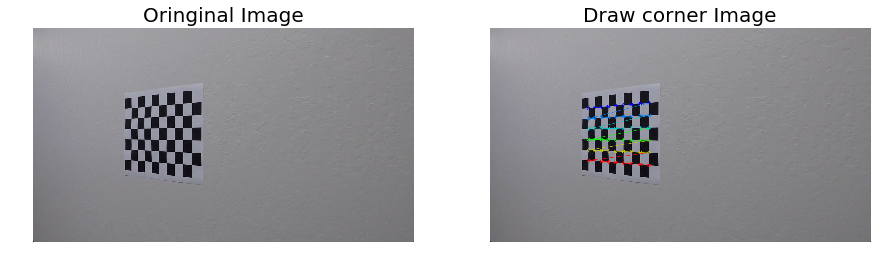

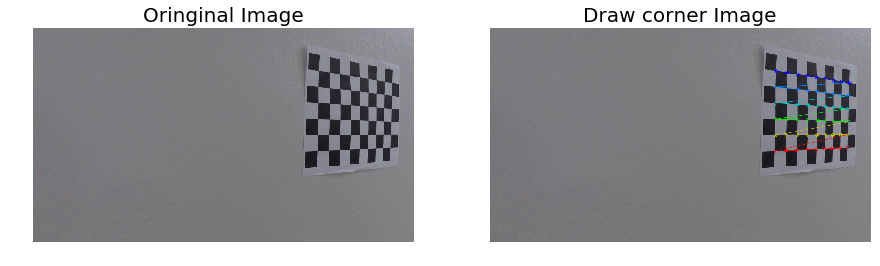

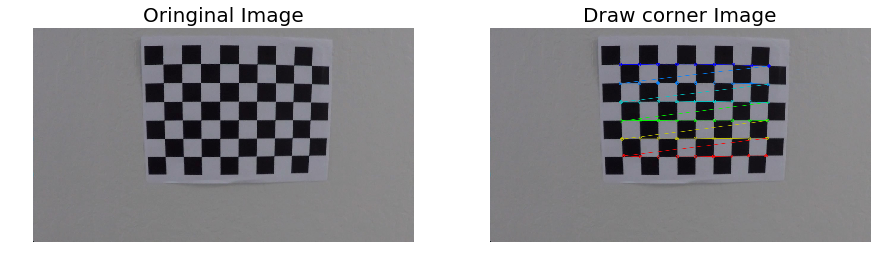

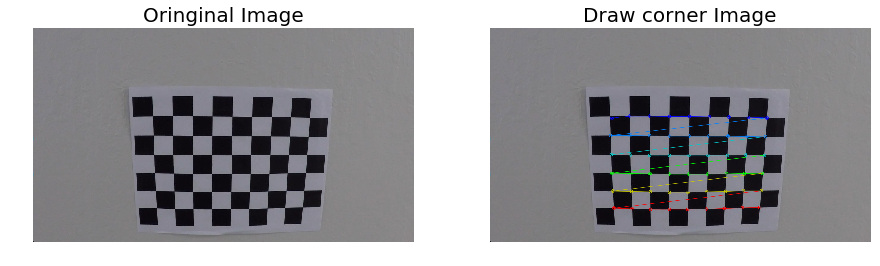

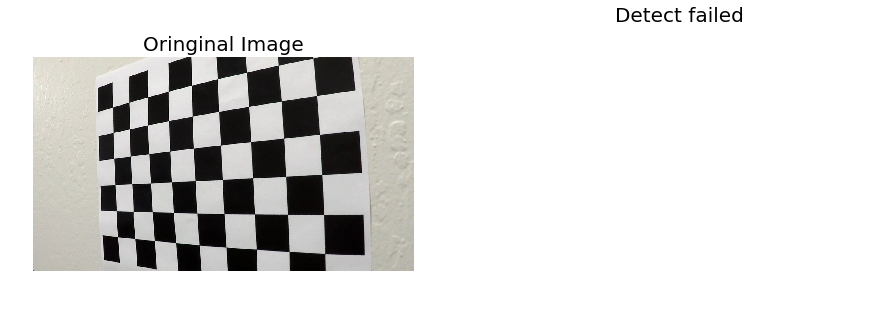

...

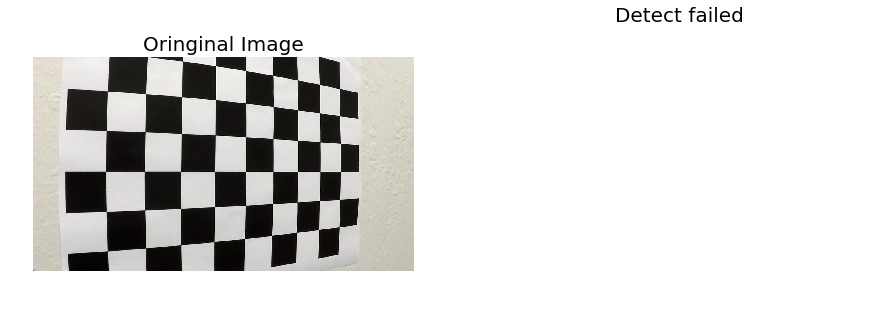

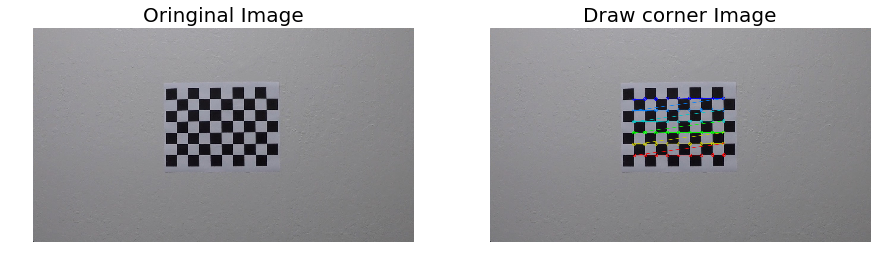

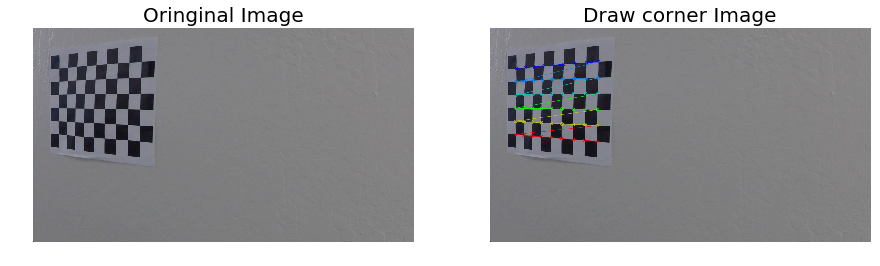

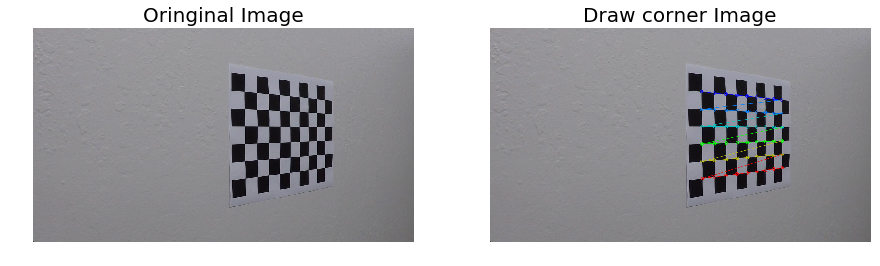

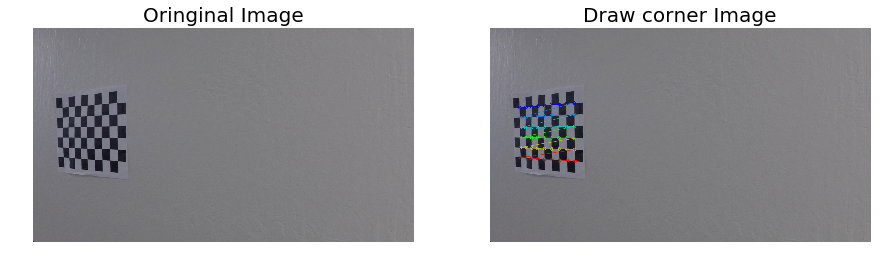

In [2]:
# Arrays to store object points and image points from all the images
objpoints = [] # 3D points in real word space
imgpoints = [] # 2d points in image plane

nx = 9 # the number of inside corners in x
ny = 6 # the number of inside corners in y

# Prepare object points, like (0,0,0), (1,0,0), (2,0,0)..., (8,5,0)
objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape([-1,2]) #x, y coordinates


# Read in and Make a list of calibration images
images = glob.glob('camera_cal/*.jpg')
for fname in images:
    img = mpimg.imread(fname)
    f, (ax1, ax2) = plt.subplots(1,2,figsize=(15,5))
    ax1.imshow(img)
    ax1.axis('off')
    ax1.set_title('Oringinal Image',fontsize=20)

    # Convert to grayscale
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    # If found, add to imgpoints
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)

        # Draw and display the corners
        image_draw_coners = cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
        ax2.imshow(image_draw_coners)
        ax2.axis('off')
        ax2.set_title('Draw corner Image',fontsize=20)
    else:
        ax2.axis('off')
        ax2.set_title('Detect failed',fontsize=20)

### Distortion correction on chessboard

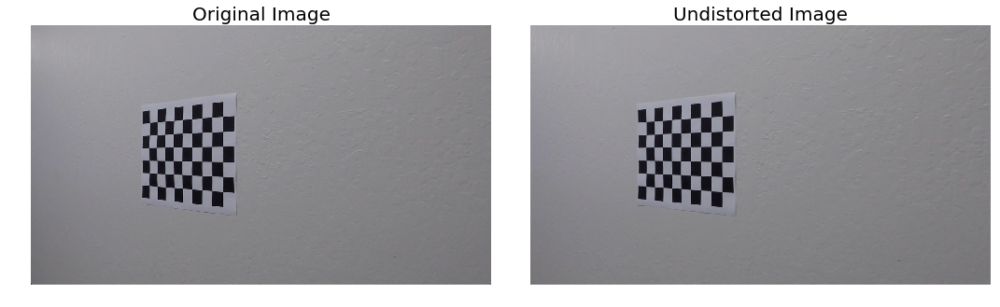

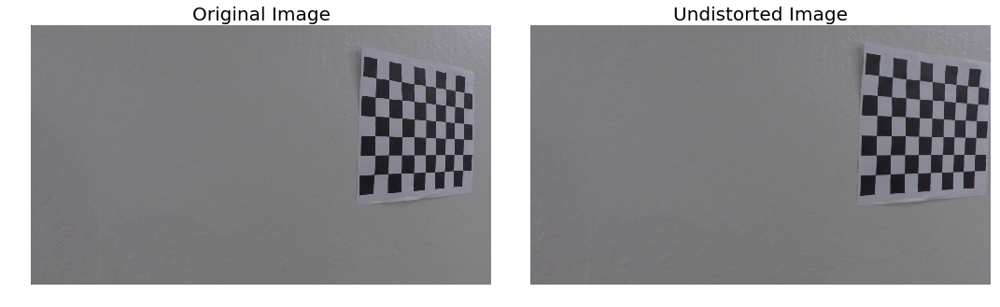

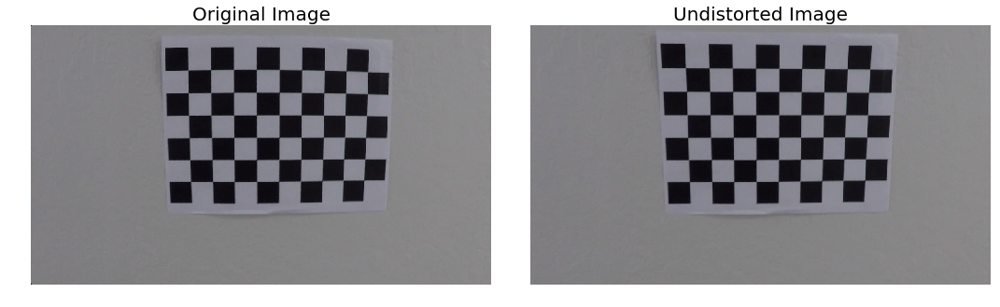

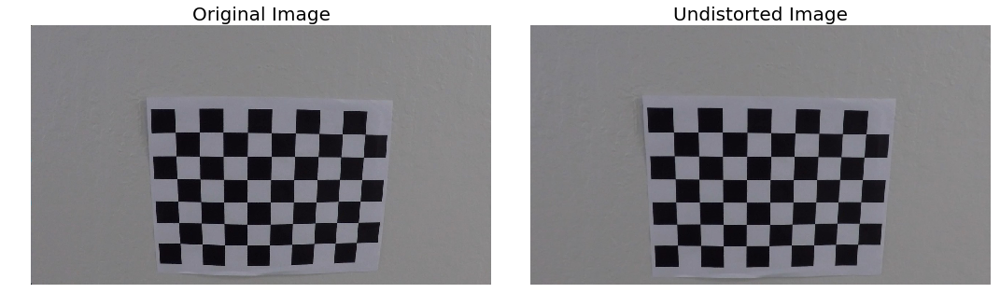

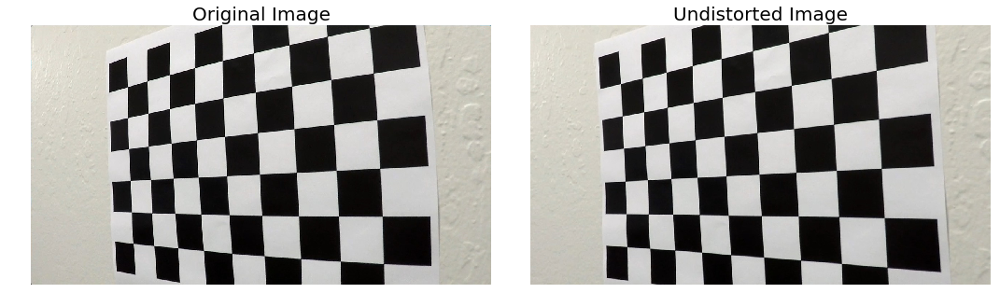

...

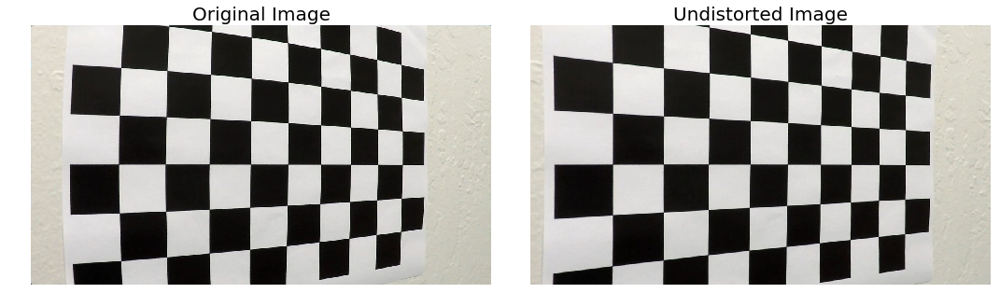

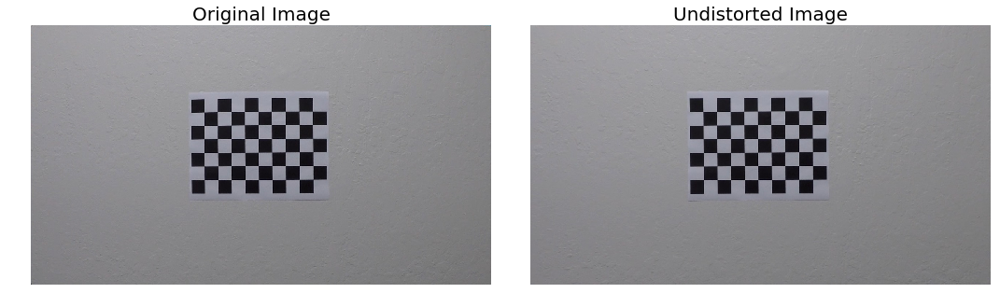

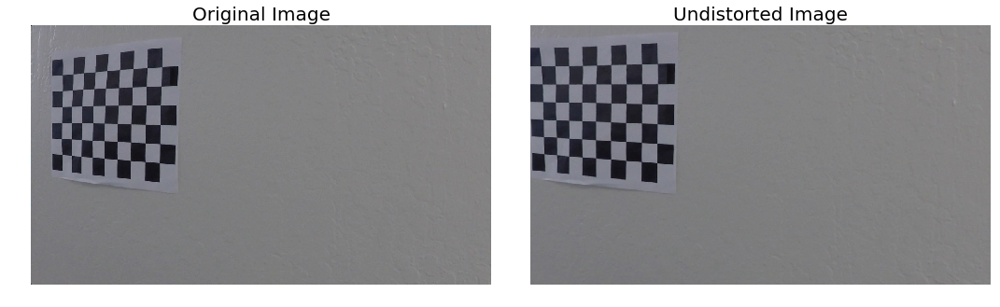

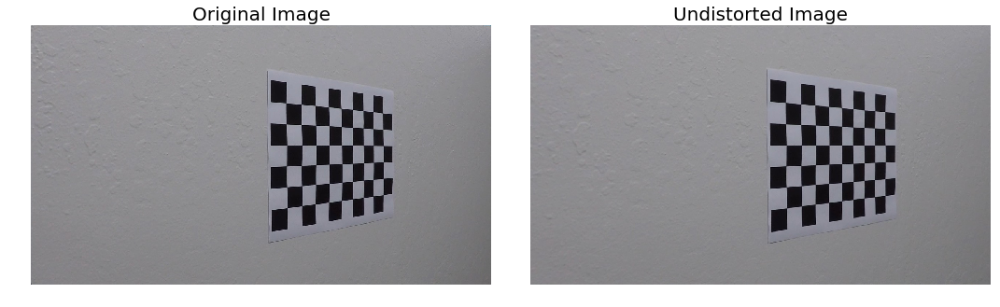

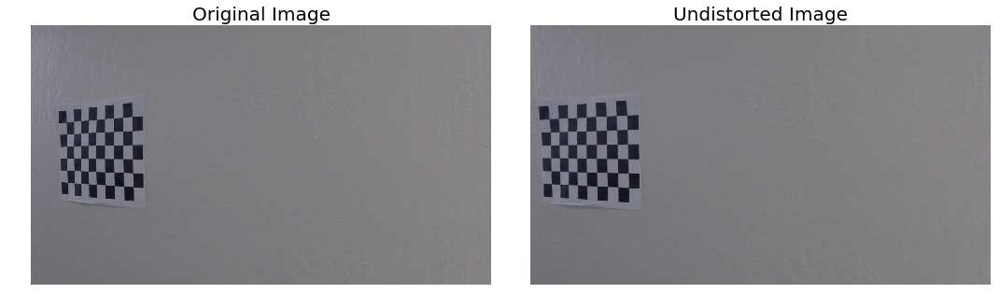

In [3]:
img = mpimg.imread(images[0])
img_size = (img.shape[1],img.shape[0])
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
for fname in images:
    img = mpimg.imread(fname)
    # undistort the image
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image',fontsize=20)
    ax1.axis('off')
    ax2.imshow(undist)
    ax2.set_title('Undistorted Image',fontsize=20)
    ax2.axis('off')

### Distortion correction on test images

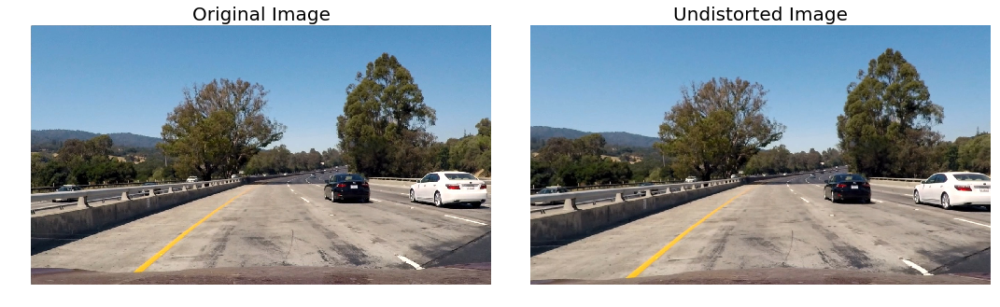

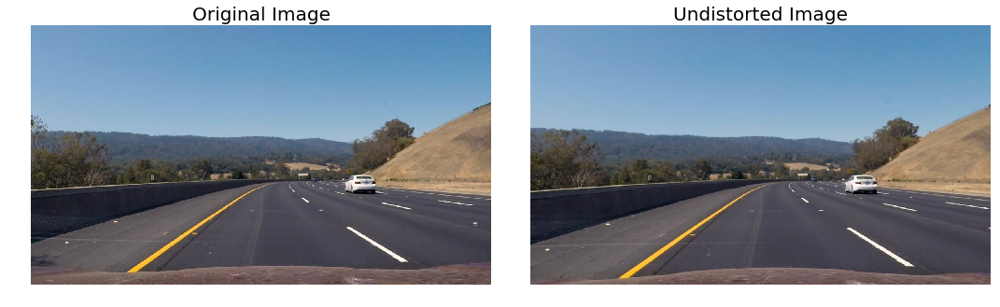

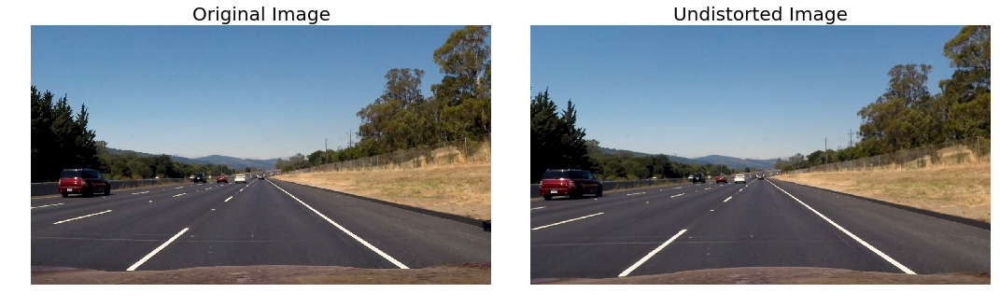

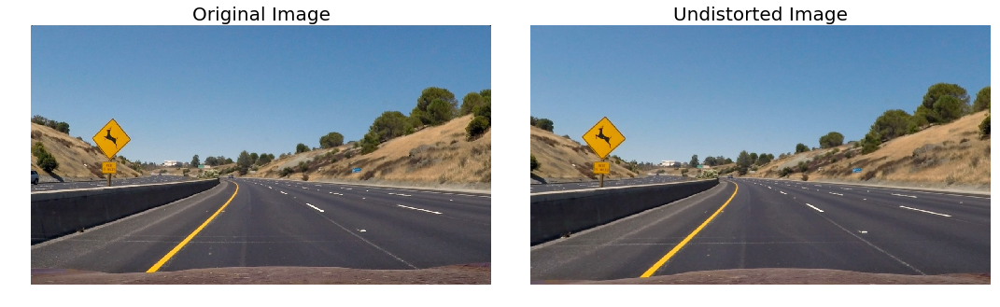

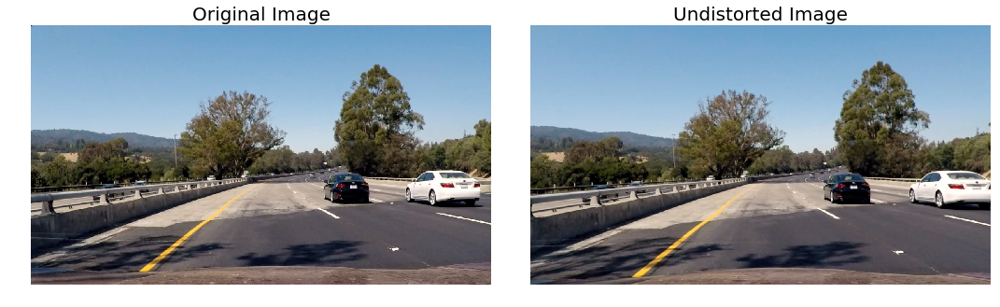

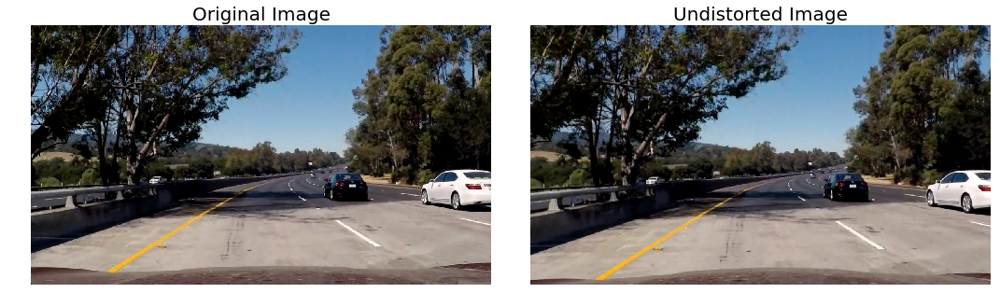

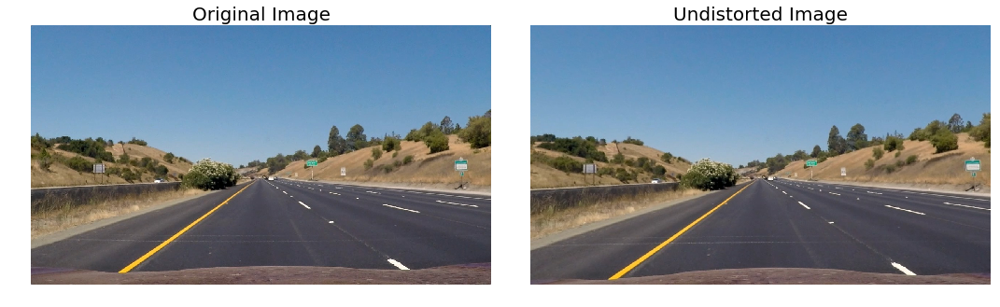

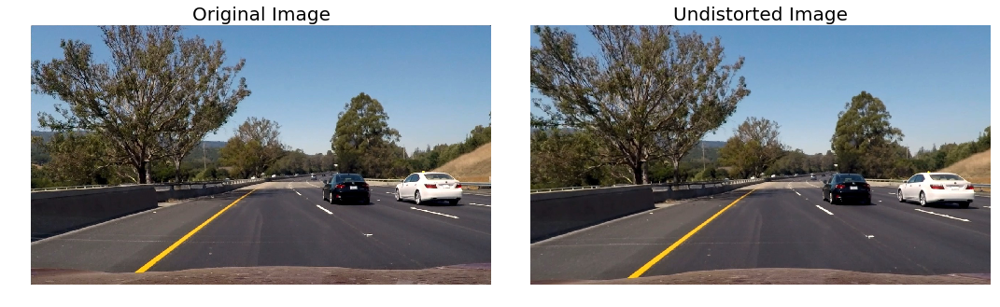

In [4]:
test_images = glob.glob('test_images/*.jpg')
for fname in test_images:
    img = mpimg.imread(fname)
    # undistort the image
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    save_undist = cv2.cvtColor(undist,cv2.COLOR_RGB2BGR)
    cv2.imwrite(os.path.join('output_images','undist_'+os.path.basename(fname)),save_undist)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image',fontsize=20)
    ax1.axis('off')
    ax2.imshow(undist)
    ax2.set_title('Undistorted Image',fontsize=20)
    ax2.axis('off')

## Perspective Transform

### On chessboard

In [5]:
def corners_unwarp(img, nx, ny):
    # Undistort using mtx and dist
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # Convert to grayscale
    gray = cv2.cvtColor(undist,cv2.COLOR_RGB2GRAY)
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    # If corners found: 
    if ret:
#         # draw corners
#         cv2.drawChessboardCorners(gray, (nx, ny), corners, ret)
#         plt.figure()
#         plt.imshow(gray)
#         plt.show()
        offset = 100 # offset for dst points
        # Grab the image shape
        img_size = (gray.shape[1], gray.shape[0])
        
        # define 4 source points 
        src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
        # define 4 destination points 
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                     [img_size[0]-offset, img_size[1]-offset], 
                                     [offset, img_size[1]-offset]])
        # get the transform matrix
        M = cv2.getPerspectiveTransform(src, dst)
        # warp image to a top-down view
        warped = cv2.warpPerspective(undist, M, img_size, flags=cv2.INTER_LINEAR)
        
        return warped, M

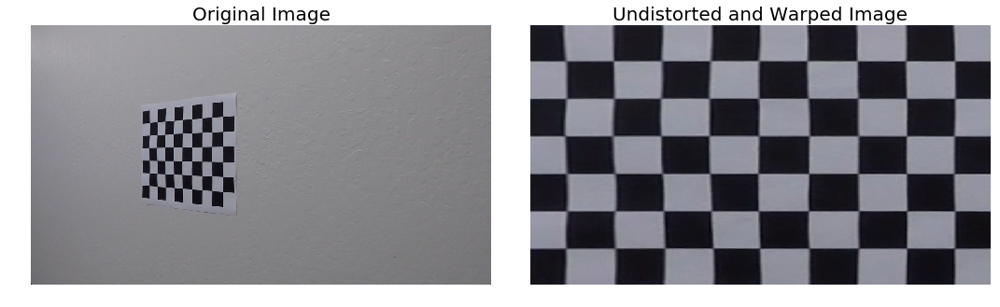

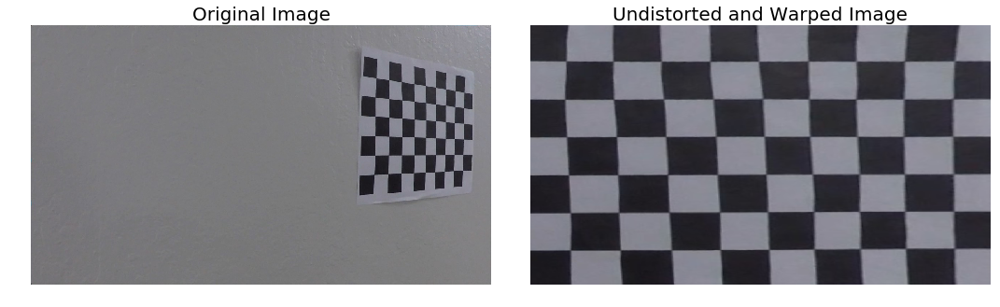

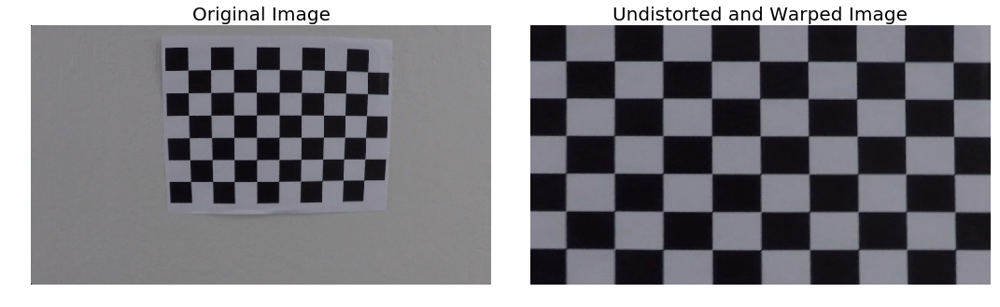

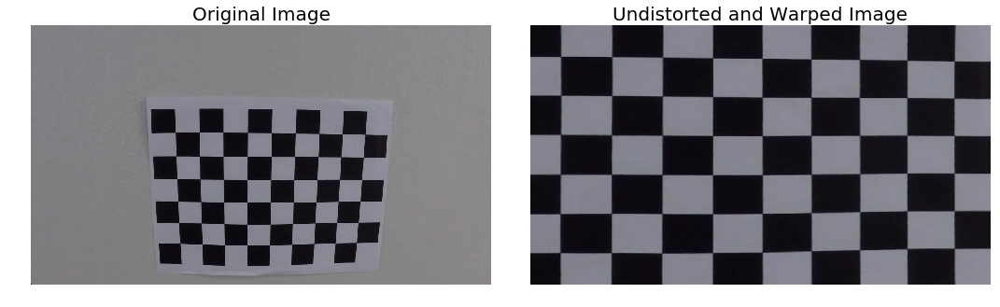

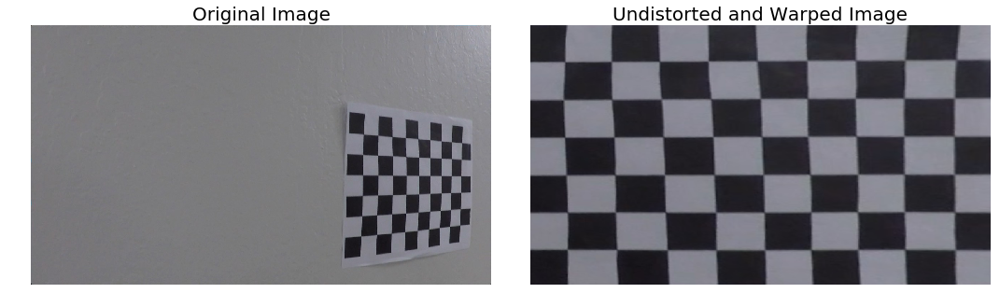

...

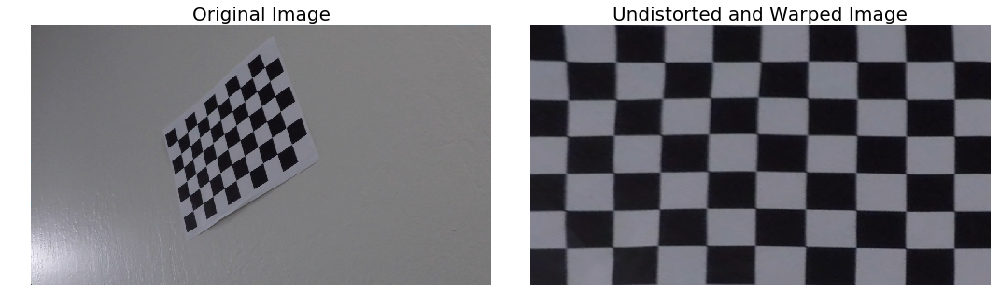

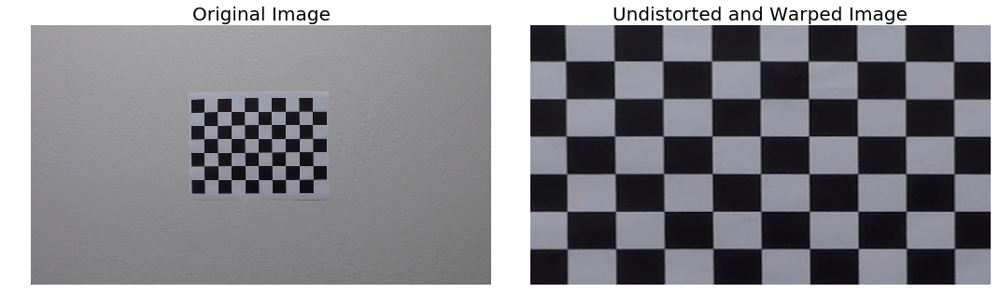

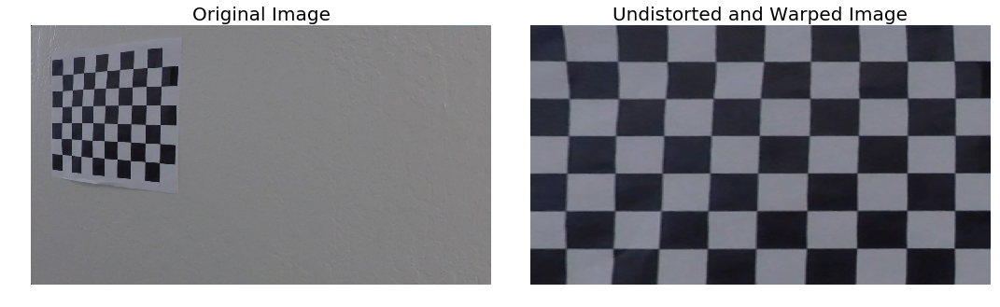

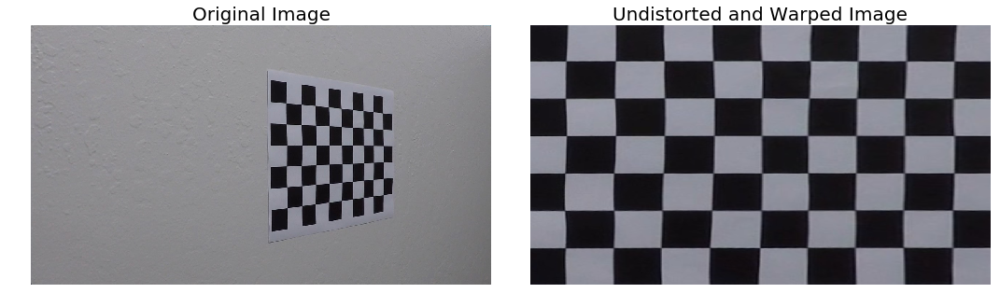

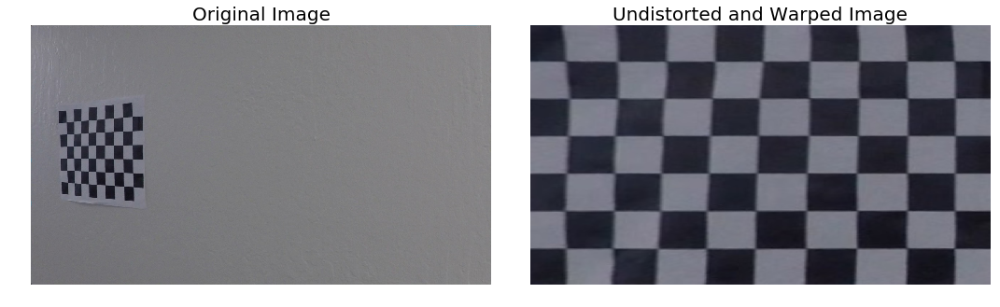

In [6]:
for fname in images:
    img = mpimg.imread(fname)
    try:
        top_down, perspective_M = corners_unwarp(img, nx, ny)
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
        f.tight_layout()
        ax1.imshow(img)
        ax1.set_title('Original Image', fontsize=20)
        ax1.axis('off')
        ax2.imshow(top_down)
        ax2.set_title('Undistorted and Warped Image', fontsize=20)
        ax2.axis('off')
    except TypeError:
        continue

### On test image

In [7]:
# work on defining perspective transformation area
img_size = (img.shape[1],img.shape[0])
offset = img_size[0]*.2
bot_width = 0.9 # percent of bootom trapizoid height 0.76 0.62
mid_width = 0.125 # percent of middle trapizoid height 0.08 0.043 0.125
height_pct = 0.64 # percent for trapizoid height 0.62 0.61 0.64
bottom_trim = 1 # percent from top to bottom to avoid car hood 0.935 
def getM_Minv(img_size,bot_width,mid_width,height_pct,bottom_trim,offset):
    src = np.float32([[img_size[0]*(0.5-mid_width/2),img_size[1]*height_pct],  # top left
                      [img_size[0]*(0.5+mid_width/2),img_size[1]*height_pct],  # top right
                      [img_size[0]*(0.5+bot_width/2),img_size[1]*bottom_trim], # bottom right
                      [img_size[0]*(0.5-bot_width/2),img_size[1]*bottom_trim]])# bottom left
    dst = np.float32([[offset, 0],                       # top left
                      [img_size[0]-offset, 0],           # top right
                      [img_size[0]-offset, img_size[1]], # bottom right
                      [offset, img_size[1]]])            # bottom left
    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst,src)
    return M,Minv
M,Minv = getM_Minv(img_size,bot_width,mid_width,height_pct,bottom_trim,offset)

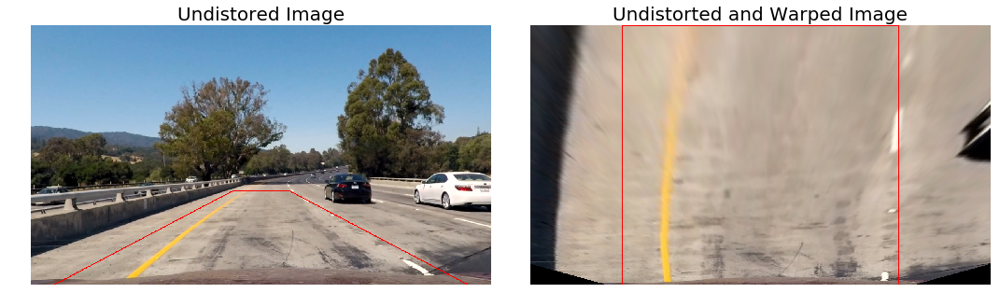

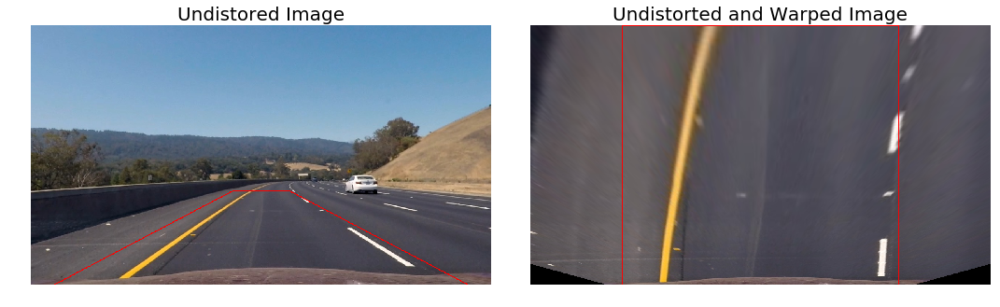

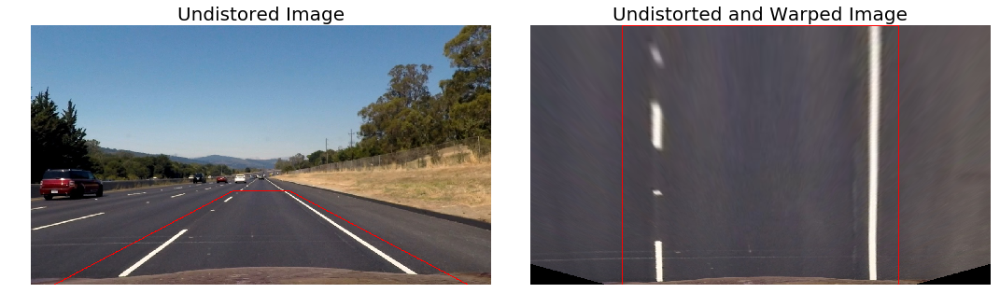

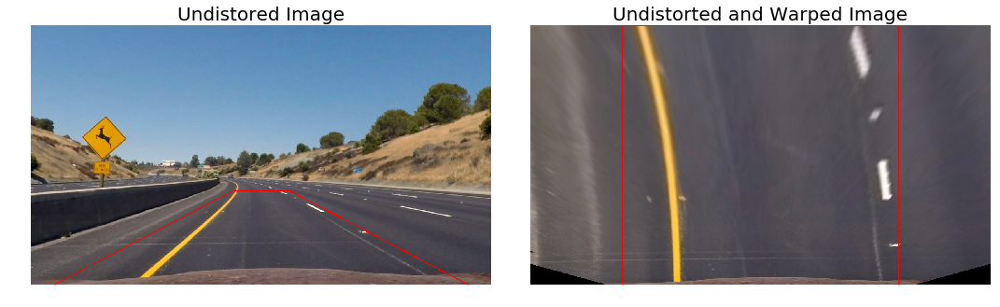

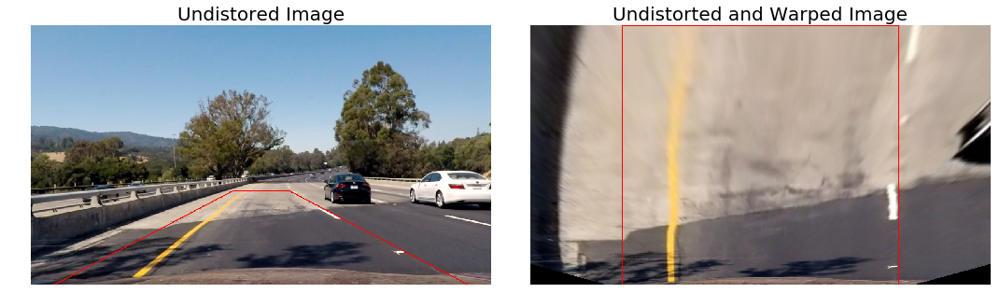

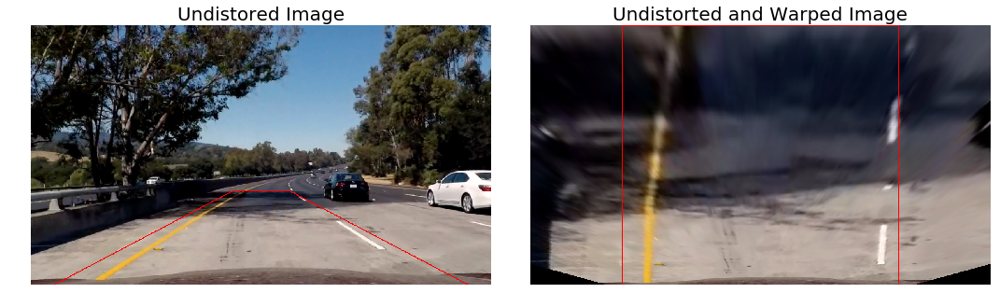

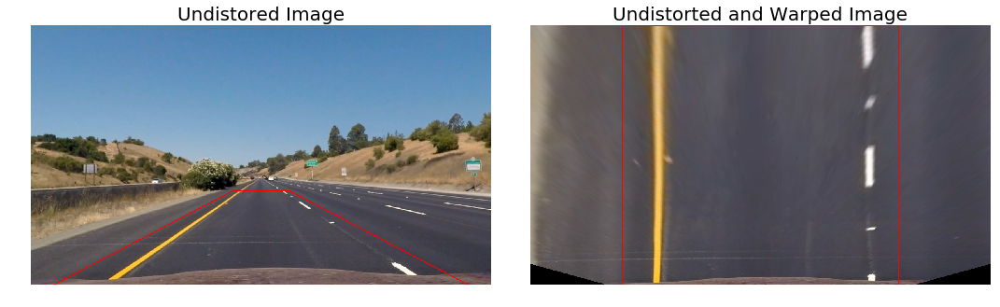

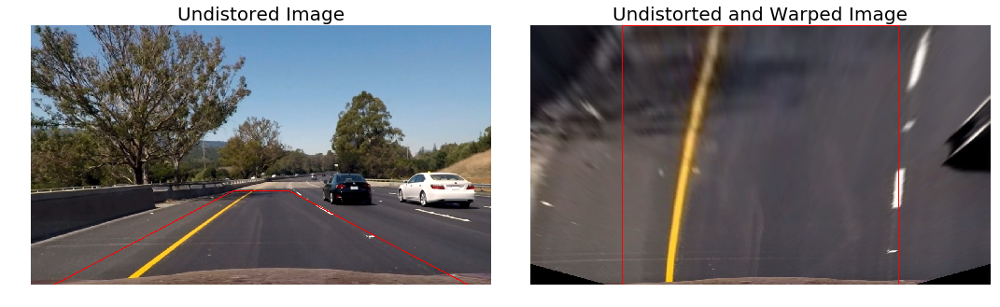

In [8]:
for fname in test_images:
    img = mpimg.imread(fname)
    # Undistort using mtx and dist
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    src = np.float32([[img_size[0]*(0.5-mid_width/2),img_size[1]*height_pct],  # top left
                      [img_size[0]*(0.5+mid_width/2),img_size[1]*height_pct],  # top right
                      [img_size[0]*(0.5+bot_width/2),img_size[1]*bottom_trim], # bottom right
                      [img_size[0]*(0.5-bot_width/2),img_size[1]*bottom_trim]])# bottom left
    dst = np.float32([[offset, 0],                       # top left
                      [img_size[0]-offset, 0],           # top right
                      [img_size[0]-offset, img_size[1]], # bottom right
                      [offset, img_size[1]]]) 
    line_src = np.array([src],dtype=np.int32)
    line_img = np.copy(undist)
    cv2.polylines(line_img,line_src,isClosed=True,color=(255,0,0),thickness=2)
    
    warped = cv2.warpPerspective(undist,M,img_size,flags=cv2.INTER_LINEAR)
    line_dst = np.array([dst],dtype=np.int32)
    
    cv2.polylines(warped,line_dst,isClosed=True,color=(255,0,0),thickness=2)
    save_warped = cv2.cvtColor(warped,cv2.COLOR_RGB2BGR)
    cv2.imwrite(os.path.join('output_images','warped_'+os.path.basename(fname)),save_warped)
    
#     cv2.imwrite('t.jpg',polyimg)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    f.tight_layout()
    ax1.imshow(line_img)
    ax1.set_title('Undistored Image', fontsize=20)
    ax1.axis('off')
    ax2.imshow(warped)
    ax2.set_title('Undistorted and Warped Image', fontsize=20)
    ax2.axis('off')


## Gradient and Color Threshold

### Gradient Threshold

In [9]:
def abs_sobel_thresh(img, orient='x', thresh=(0,255)):
    '''
    Identify pixels where the gradient of an image falls within a specified threshold range.
    '''
    
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(img, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(img, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(img)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    # Return the result
    return binary_output

def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    '''
    Calculate the magnitude of the gradient
    for a given sobel kernel size and threshold values
    '''
    
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(img)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

def dir_threshold(img, sobel_kernel=3, dir_thresh=(0, np.pi/2)):
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(img)
    binary_output[(absgraddir >= dir_thresh[0]) & (absgraddir <= dir_thresh[1])] = 1

    # Return the binary image
    return binary_output

### Color Threshold

In [10]:
def color_select(img,color_space,color_channel,thresh=(0, 255)):
    if color_space == 'RGB':
        channel = img[:,:,color_space.index(color_channel)]
    else:
        space = eval('cv2.cvtColor(img, cv2.COLOR_RGB2%s)'%color_space)
        channel = space[:,:,color_space.index(color_channel)]
    binary_output = np.zeros_like(channel)
    binary_output[(channel > thresh[0]) & (channel <= thresh[1])] = 1
    return binary_output

### Color space

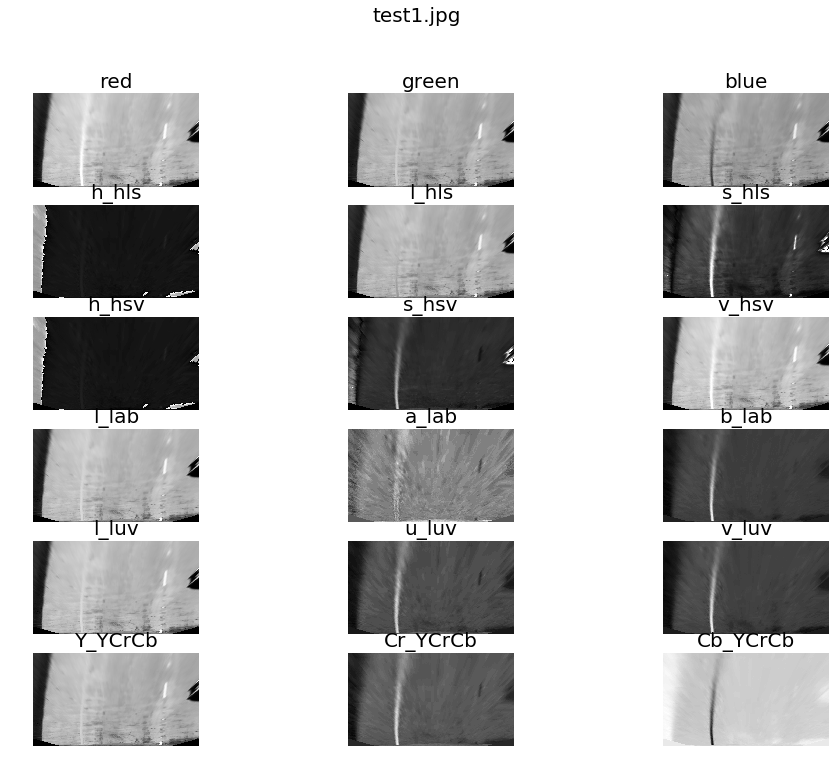

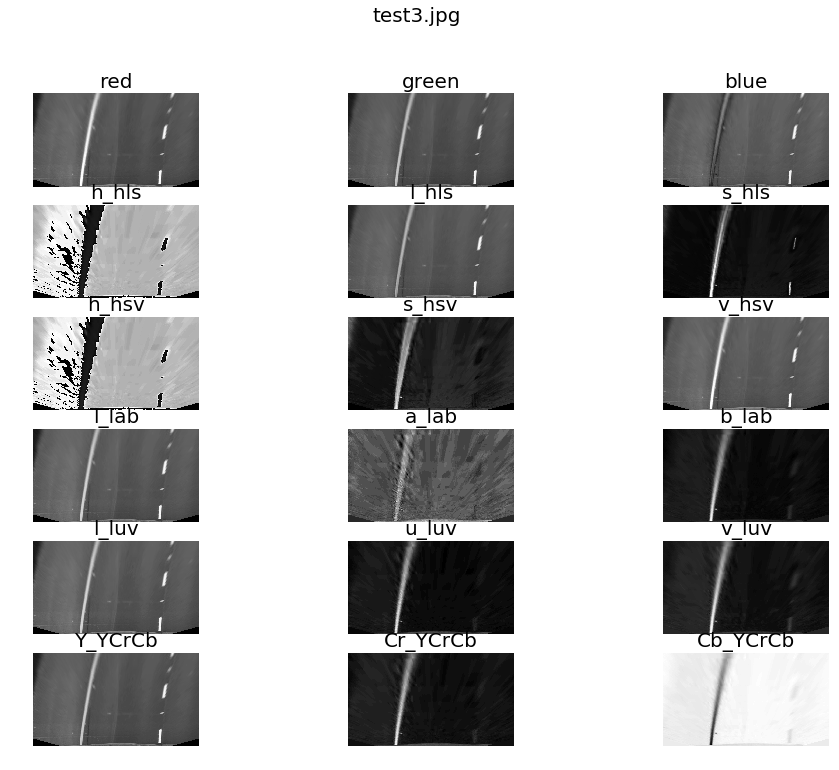

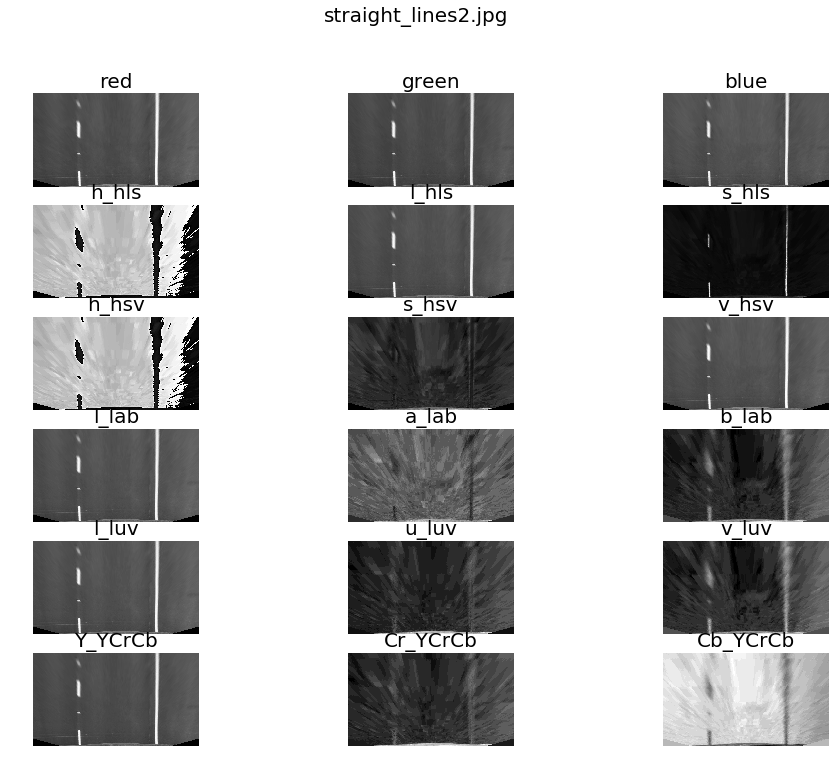

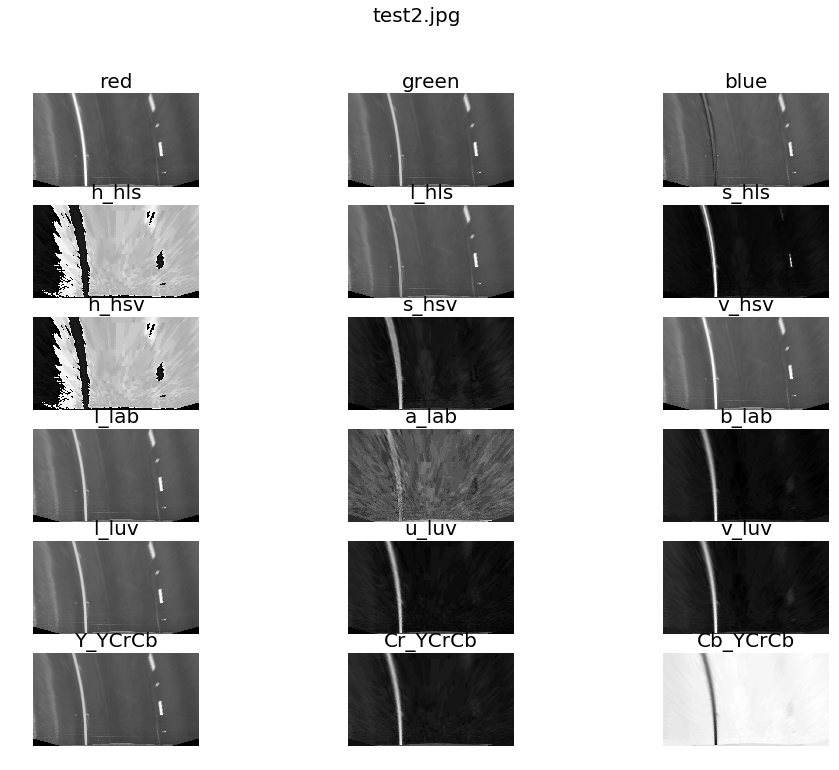

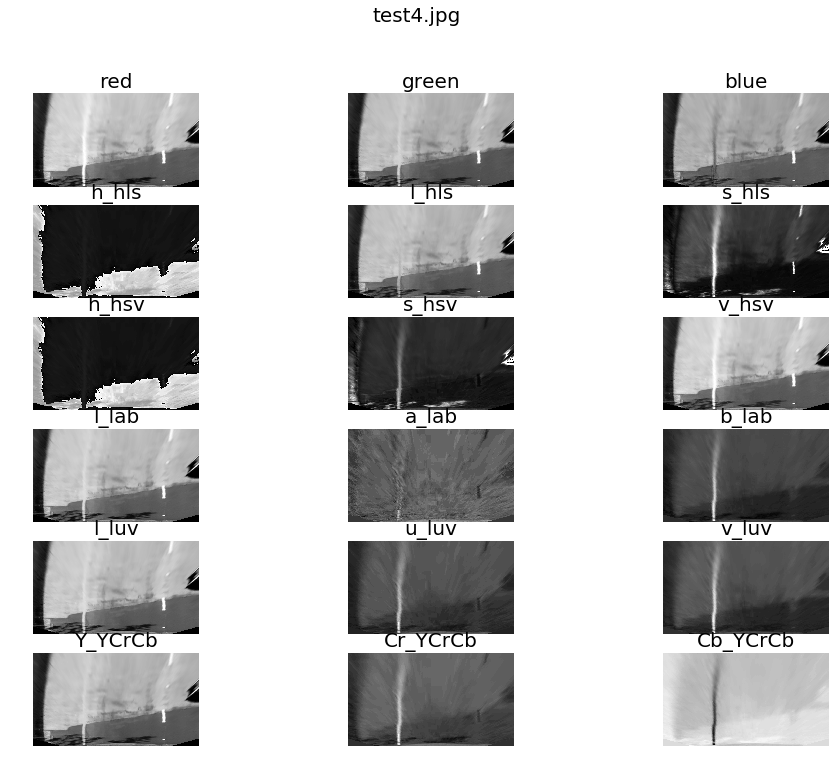

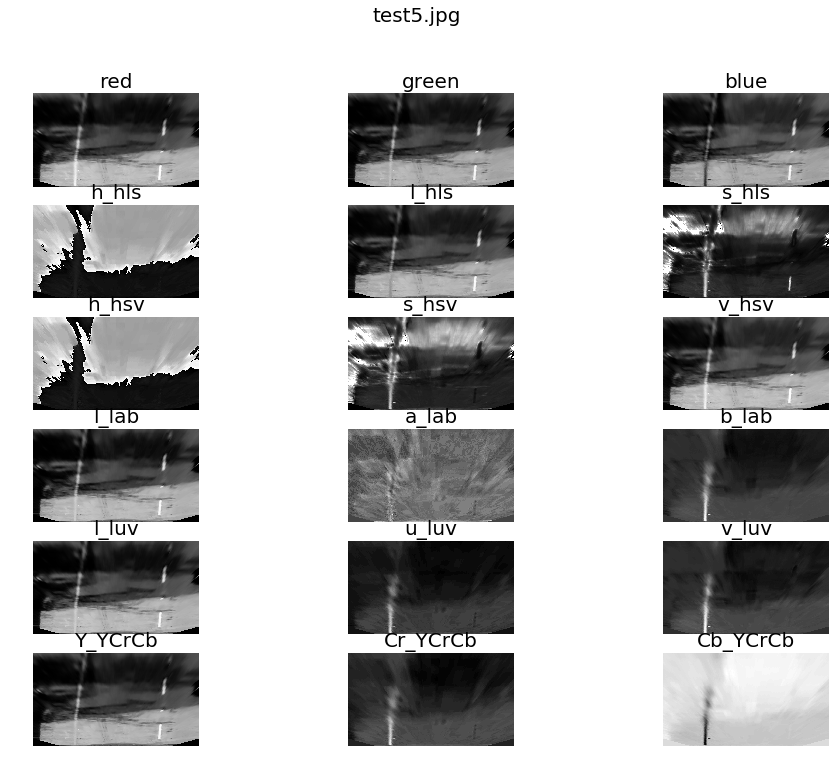

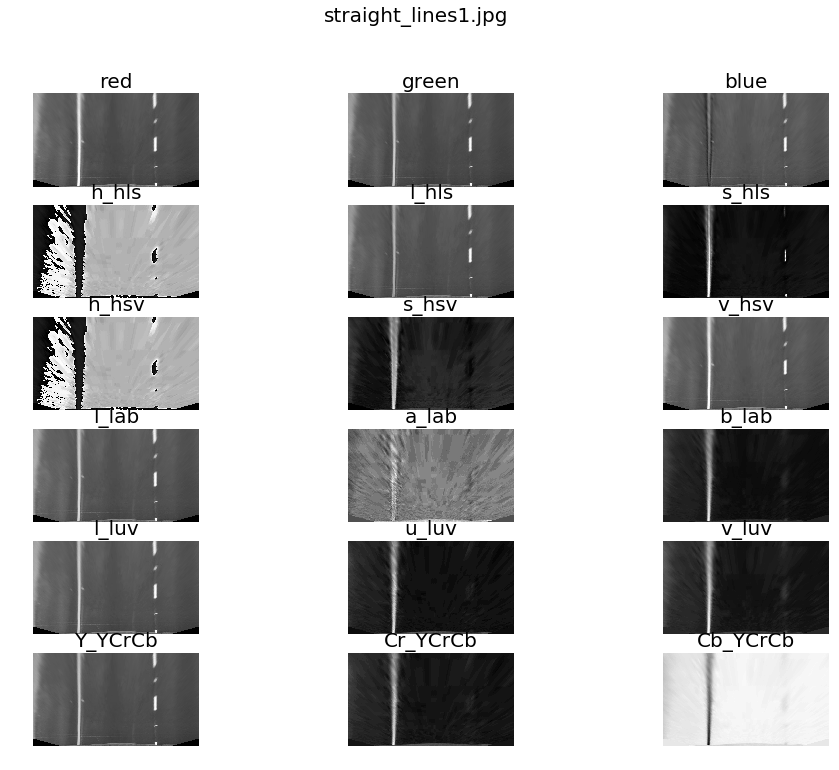

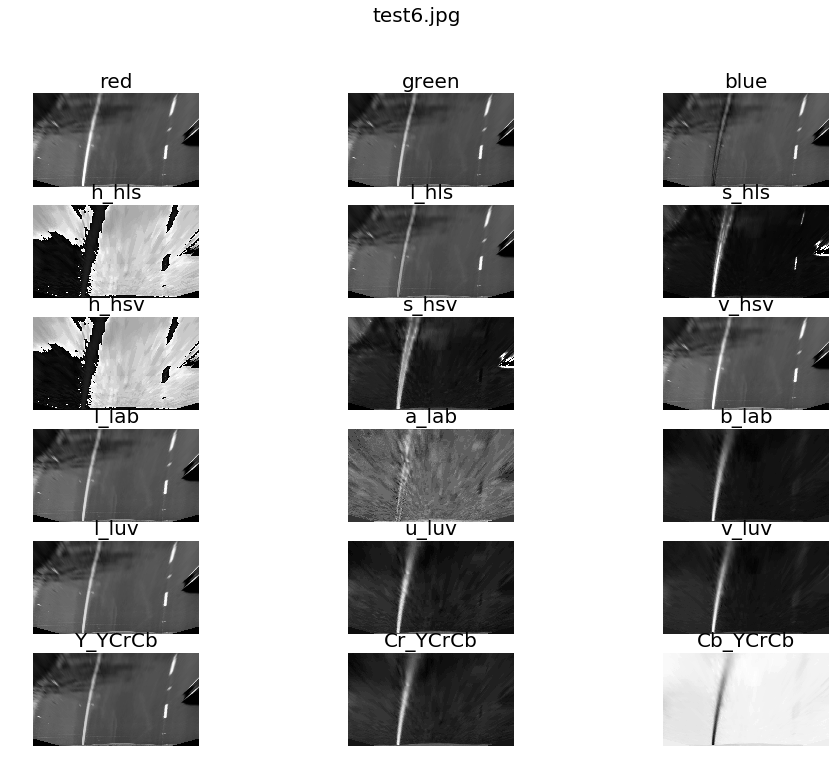

In [11]:
for fname in test_images:
    image = mpimg.imread(fname)
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    warped = cv2.warpPerspective(undist,M,img_size,flags=cv2.INTER_LINEAR)
    
    show_images = []
    titles = []
    # Use RGB
    r = warped[:,:,0]
    g = warped[:,:,1]
    b = warped[:,:,2]
    show_images.extend([r,g,b])
    titles.extend(['red','green','blue'])
    
    # Use HLS
    hls = cv2.cvtColor(warped, cv2.COLOR_RGB2HLS)
    h_hls = hls[:,:,0]
    l_hls = hls[:,:,1]
    s_hls = hls[:,:,2]
    show_images.extend([h_hls,l_hls,s_hls])
    titles.extend(['h_hls','l_hls','s_hls'])
    
    # Use HSV
    hsv = cv2.cvtColor(warped, cv2.COLOR_RGB2HSV)
    h_hsv = hsv[:,:,0]
    s_hsv = hsv[:,:,1]
    v_hsv = hsv[:,:,2]
    show_images.extend([h_hsv,s_hsv,v_hsv])
    titles.extend(['h_hsv','s_hsv','v_hsv'])
    
    # Use LAB
    lab = cv2.cvtColor(warped, cv2.COLOR_RGB2LAB)
    l_lab = lab[:,:,0]
    a_lab = lab[:,:,1]
    b_lab = lab[:,:,2]
    show_images.extend([l_lab,a_lab,b_lab])
    titles.extend(['l_lab','a_lab','b_lab'])
    
    # Use LUV
    luv = cv2.cvtColor(warped, cv2.COLOR_RGB2LUV)
    l_luv = luv[:,:,0]
    u_luv = luv[:,:,1]
    v_luv = luv[:,:,2]
    show_images.extend([l_luv,u_luv,v_luv])
    titles.extend(['l_luv','u_luv','v_luv'])
    
    # Use YCrCb
    YCrCb = cv2.cvtColor(warped, cv2.COLOR_RGB2YCrCb)
    Y_YCrCb = YCrCb[:,:,0]
    Cr_YCrCb = YCrCb[:,:,1]
    Cb_YCrCb = YCrCb[:,:,2]
    show_images.extend([Y_YCrCb,Cr_YCrCb,Cb_YCrCb])
    titles.extend(['Y_YCrCb','Cr_YCrCb','Cb_YCrCb'])
    
    
    
    f, axes = plt.subplots(6, 3, figsize=(16, 12))
    f.suptitle(os.path.basename(fname), fontsize=20)
    axes = axes.ravel()
    for i in range(len(axes)):
        axes[i].imshow(show_images[i],'gray')
        axes[i].set_title(titles[i], fontsize=20)
        axes[i].axis('off')
    

Just look at the channels perform well.

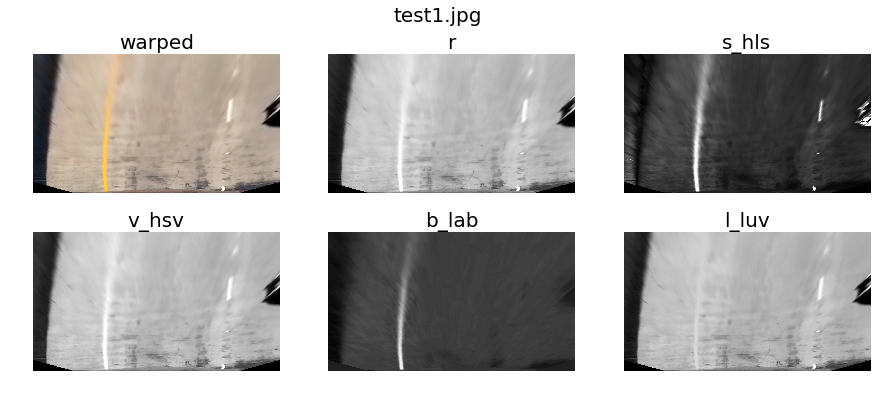

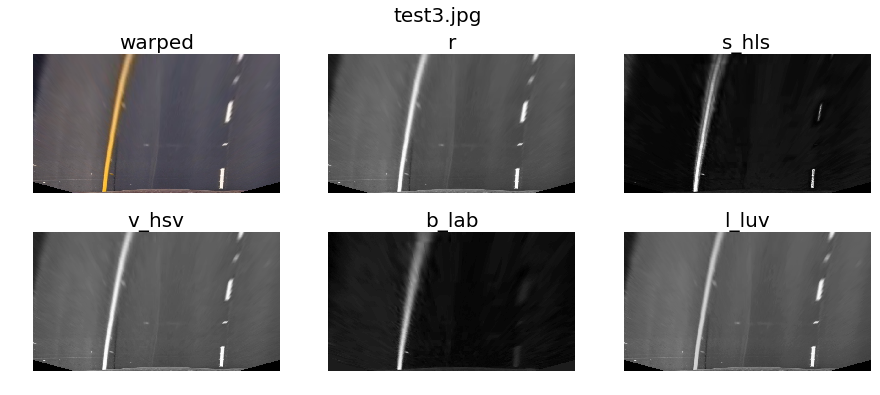

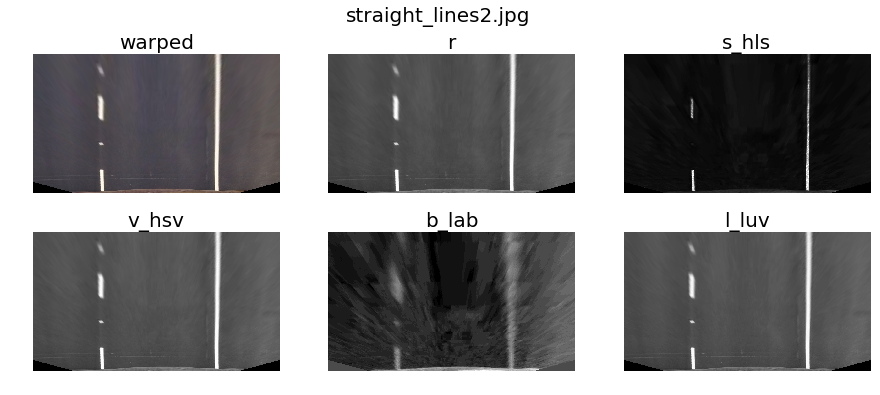

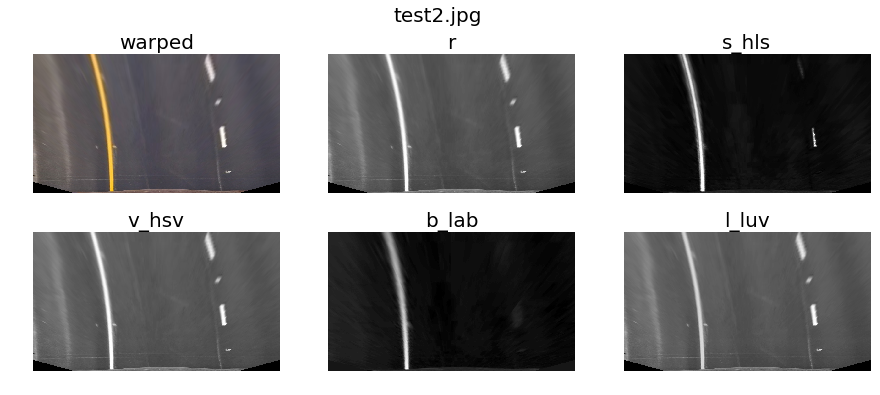

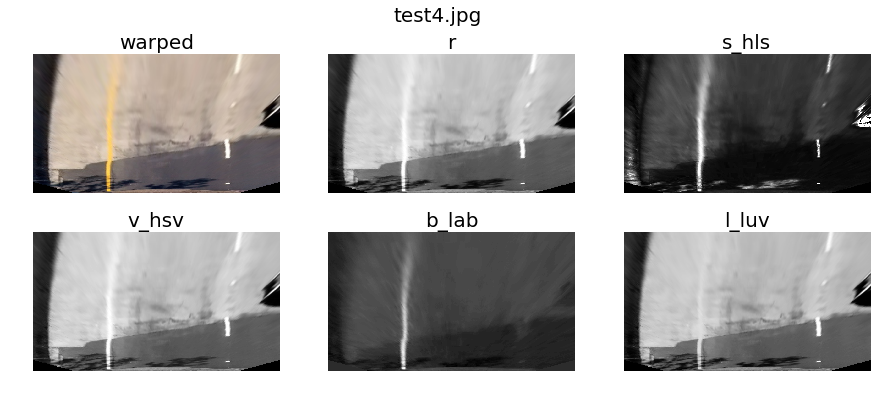

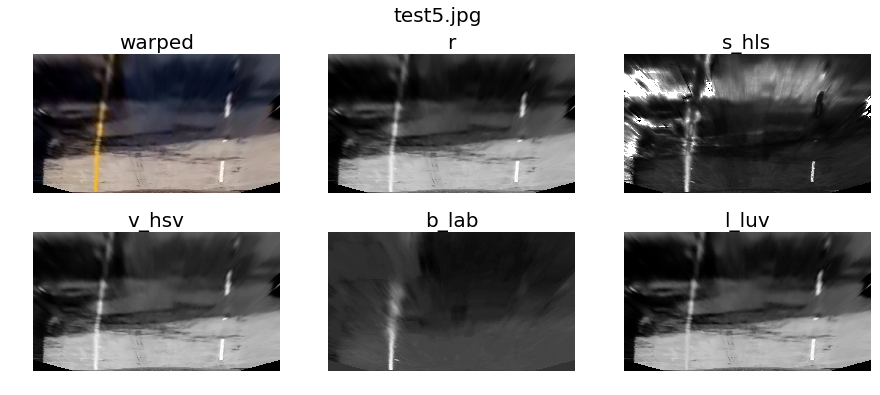

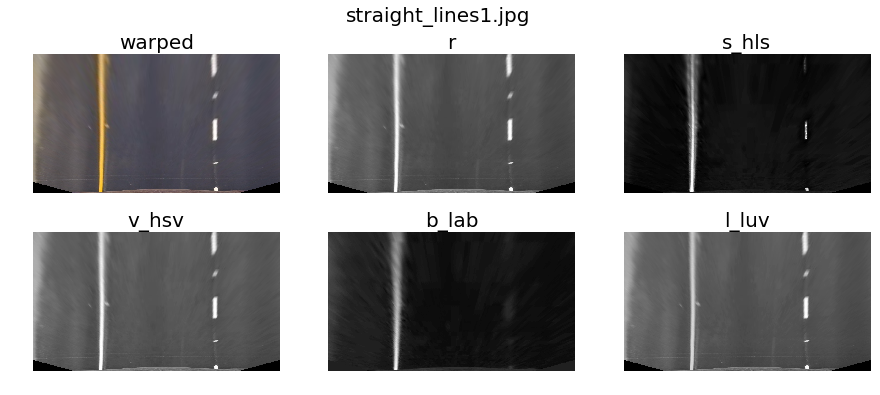

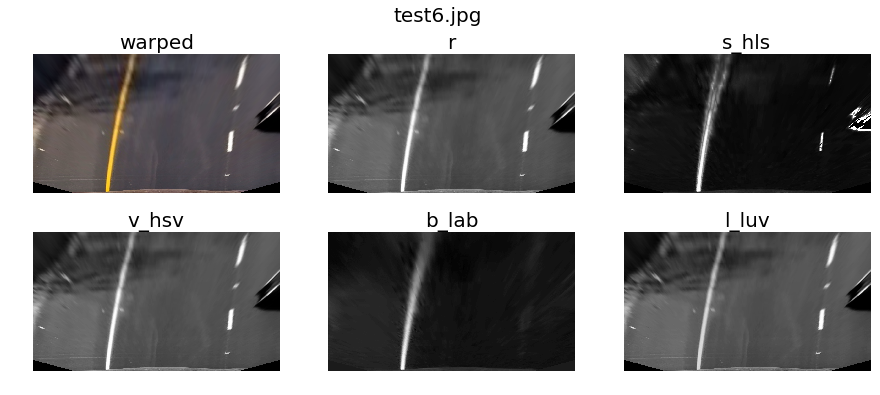

In [12]:
for fname in test_images:
    image = mpimg.imread(fname)
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    warped = cv2.warpPerspective(undist,M,img_size,flags=cv2.INTER_LINEAR)
    
    show_images = [warped]
    titles = ['warped']
    # Use RGB
    r = warped[:,:,0]
    g = warped[:,:,1]
    b = warped[:,:,2]
    
    # Use HLS
    hls = cv2.cvtColor(warped, cv2.COLOR_RGB2HLS)
    h_hls = hls[:,:,0]
    l_hls = hls[:,:,1]
    s_hls = hls[:,:,2]
    
    # Use HSV
    hsv = cv2.cvtColor(warped, cv2.COLOR_RGB2HSV)
    h_hsv = hsv[:,:,0]
    s_hsv = hsv[:,:,1]
    v_hsv = hsv[:,:,2]
    
    # Use LAB
    lab = cv2.cvtColor(warped, cv2.COLOR_RGB2LAB)
    l_lab = lab[:,:,0]
    a_lab = lab[:,:,1]
    b_lab = lab[:,:,2]
    
    # Use LUV
    luv = cv2.cvtColor(warped, cv2.COLOR_RGB2LUV)
    l_luv = luv[:,:,0]
    u_luv = luv[:,:,1]
    v_luv = luv[:,:,2]

    show_images = [warped,r,s_hls,v_hsv,b_lab,l_luv]
    titles = ['warped','r','s_hls','v_hsv','b_lab','l_luv']
    f, axes = plt.subplots(2, 3, figsize=(15, 6))
    f.suptitle(os.path.basename(fname), fontsize=20)
    axes = axes.ravel()
    for i in range(len(axes)):
        axes[i].imshow(show_images[i],'gray')
        axes[i].set_title(titles[i], fontsize=20)
        axes[i].axis('off')
    
    

### Display images that processed by different methods

In [13]:
def gradient_thresh_interactive(img,
                             ksize=15,
                             grad_x_min=17,grad_x_max=255,
                             grad_y_min=4,  grad_y_max=255,
                             mag_thresh_min=33,mag_thresh_max=255,
                             dir_thresh_min=0.0,dir_thresh_max=0.4):
    
    warped = cv2.warpPerspective(img,M,img_size,flags=cv2.INTER_LINEAR)
    
    # color and gradient threshold
    hsv = cv2.cvtColor(warped, cv2.COLOR_RGB2HSV)
    v_channel = hsv[:,:,2]
    gradx = abs_sobel_thresh(v_channel,orient='x',thresh=(grad_x_min,grad_x_max))
    grady = abs_sobel_thresh(v_channel,orient='y',thresh=(grad_y_min,grad_y_max))
    mag_binary = mag_thresh(v_channel, sobel_kernel=ksize, mag_thresh=(mag_thresh_min, mag_thresh_max))
    dir_binary = dir_threshold(v_channel, sobel_kernel=ksize, dir_thresh=(dir_thresh_min, dir_thresh_max))
    
    combined = np.zeros_like(img[:,:,0])
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1

    
   # warped_binary = cv2.warpPerspective(combined,M,img_size,flags=cv2.INTER_LINEAR)
    
    show_images = [v_channel,gradx,grady,mag_binary,dir_binary,combined]
    titles = ['v_channel','gradx','grady','mag_binary','dir_binary','combined']
    f, axes = plt.subplots(2, 3, figsize=(15, 6))
    axes = axes.ravel()
    for i in range(len(axes)):
        axes[i].imshow(show_images[i],'gray')
        axes[i].set_title(titles[i], fontsize=20)
        axes[i].axis('off')

In [14]:
img = mpimg.imread('test_images/test5.jpg')
undist = cv2.undistort(img, mtx, dist, None, mtx)
interact(gradient_thresh_interactive,img=fixed(undist),
         ksize=(1,31,2),
         grad_x_min=(0,255),grad_x_max=(0,255),
         grad_y_min=(0,255),grad_y_max=(0,255),
         mag_thresh_min=(0,255),mag_thresh_max=(0,255),
         dir_thresh_min=(0,2,0.1),dir_thresh_max=(0,2,0.1))

interactive(children=(IntSlider(value=15, description='ksize', max=31, min=1, step=2), IntSlider(value=17, des…

<function __main__.gradient_thresh_interactive(img, ksize=15, grad_x_min=17, grad_x_max=255, grad_y_min=4, grad_y_max=255, mag_thresh_min=33, mag_thresh_max=255, dir_thresh_min=0.0, dir_thresh_max=0.4)>

In [15]:
def color_thresh_interactive(img,
                             rgb_r_thresh_min=225,rgb_r_thresh_max=255,
                             lab_b_thresh_min=150,lab_b_thresh_max=255,
                             luv_l_thresh_min=209,luv_l_thresh_max=255):
    
    warped = cv2.warpPerspective(img,M,img_size,flags=cv2.INTER_LINEAR)
    
    # color threshold 
    r_rgb = color_select(warped, 'RGB', 'R', (rgb_r_thresh_min,rgb_r_thresh_max))
    b_lab = color_select(warped, 'LAB', 'B', (lab_b_thresh_min,lab_b_thresh_max))
    l_luv = color_select(warped, 'LUV', 'L', (luv_l_thresh_min,luv_l_thresh_max))
    
    
    combined = np.zeros_like(img[:,:,0])
    combined[(b_lab==1)|(l_luv==1)|(r_rgb==1)]=1
    
    show_images = [r_rgb,b_lab,l_luv,combined]
    titles = ['r_rgb','b_lab','l_luv','combined']
    plt.imshow(warped)
    plt.axis('off')
    plt.title('image')
    f, axes = plt.subplots(2, 2, figsize=(15, 6))
    axes = axes.ravel()
    for i in range(len(axes)):
        axes[i].imshow(show_images[i],'gray')
        axes[i].set_title(titles[i], fontsize=20)
        axes[i].axis('off')

In [16]:
img = mpimg.imread('test_images/test5.jpg')
undist = cv2.undistort(img, mtx, dist, None, mtx)
interact(color_thresh_interactive,img=fixed(undist),
         rgb_r_thresh_min=(0,255),rgb_r_thresh_max=(0,255),
         lab_b_thresh_min=(0,255),lab_b_thresh_max=(0,255),
         luv_l_thresh_min=(0,255),luv_l_thresh_max=(0,255))

interactive(children=(IntSlider(value=225, description='rgb_r_thresh_min', max=255), IntSlider(value=255, desc…

<function __main__.color_thresh_interactive(img, rgb_r_thresh_min=225, rgb_r_thresh_max=255, lab_b_thresh_min=150, lab_b_thresh_max=255, luv_l_thresh_min=209, luv_l_thresh_max=255)>

In [17]:
def thresh_interactive(img,
                     ksize=15,
                     grad_x_min=17,grad_x_max=255,
                     grad_y_min=4,  grad_y_max=255,
                     mag_thresh_min=33,mag_thresh_max=255,
                     dir_thresh_min=0.0,dir_thresh_max=0.4,
                     rgb_r_thresh_min=225,rgb_r_thresh_max=255,
                     lab_b_thresh_min=150,lab_b_thresh_max=255,
                     luv_l_thresh_min=212,luv_l_thresh_max=255):
    
    warped = cv2.warpPerspective(img,M,img_size,flags=cv2.INTER_LINEAR)
    
    # gradient threshold
    hsv = cv2.cvtColor(warped, cv2.COLOR_RGB2HSV)
    v_channel = hsv[:,:,2]
    gradx = abs_sobel_thresh(v_channel,orient='x',thresh=(grad_x_min,grad_x_max))
    grady = abs_sobel_thresh(v_channel,orient='y',thresh=(grad_y_min,grad_y_max))
    mag_binary = mag_thresh(v_channel, sobel_kernel=ksize, mag_thresh=(mag_thresh_min, mag_thresh_max))
    dir_binary = dir_threshold(v_channel, sobel_kernel=ksize, dir_thresh=(dir_thresh_min, dir_thresh_max))
    
    # color threshold 
    r_rgb = color_select(warped, 'RGB', 'R', (rgb_r_thresh_min,rgb_r_thresh_max))
    b_lab = color_select(warped, 'LAB', 'B', (lab_b_thresh_min,lab_b_thresh_max))
    l_luv = color_select(warped, 'LUV', 'L', (luv_l_thresh_min,luv_l_thresh_max))
    
    
    combined = np.zeros_like(img[:,:,0])
    combined[((b_lab==1)|(l_luv==1)|(r_rgb==1)|(gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    plt.imshow(warped)
    plt.axis('off')
    plt.title('image')
    
    show_images = [r_rgb,b_lab,l_luv,v_channel,gradx,grady,mag_binary,dir_binary,combined]
    titles = ['r_rgb','b_lab','l_luv','v_channel','gradx','grady','mag_binary','dir_binary','combined']
    f, axes = plt.subplots(3, 3, figsize=(15, 6))
    axes = axes.ravel()
    for i in range(len(axes)):
        axes[i].imshow(show_images[i],'gray')
        axes[i].set_title(titles[i], fontsize=20)
        axes[i].axis('off')

In [18]:
img = mpimg.imread('test_images/test5.jpg')
undist = cv2.undistort(img, mtx, dist, None, mtx)
interact(thresh_interactive,img=fixed(undist),
         ksize=(1,31,2),
         grad_x_min=(0,255),grad_x_max=(0,255),
         grad_y_min=(0,255),grad_y_max=(0,255),
         mag_thresh_min=(0,255),mag_thresh_max=(0,255),
         dir_thresh_min=(0,2,0.1),dir_thresh_max=(0,2,0.1),
         rgb_r_thresh_min=(0,255),rgb_r_thresh_max=(0,255),
         lab_b_thresh_min=(0,255),lab_b_thresh_max=(0,255),
         luv_l_thresh_min=(0,255),luv_l_thresh_max=(0,255))

interactive(children=(IntSlider(value=15, description='ksize', max=31, min=1, step=2), IntSlider(value=17, des…

<function __main__.thresh_interactive(img, ksize=15, grad_x_min=17, grad_x_max=255, grad_y_min=4, grad_y_max=255, mag_thresh_min=33, mag_thresh_max=255, dir_thresh_min=0.0, dir_thresh_max=0.4, rgb_r_thresh_min=225, rgb_r_thresh_max=255, lab_b_thresh_min=150, lab_b_thresh_max=255, luv_l_thresh_min=212, luv_l_thresh_max=255)>

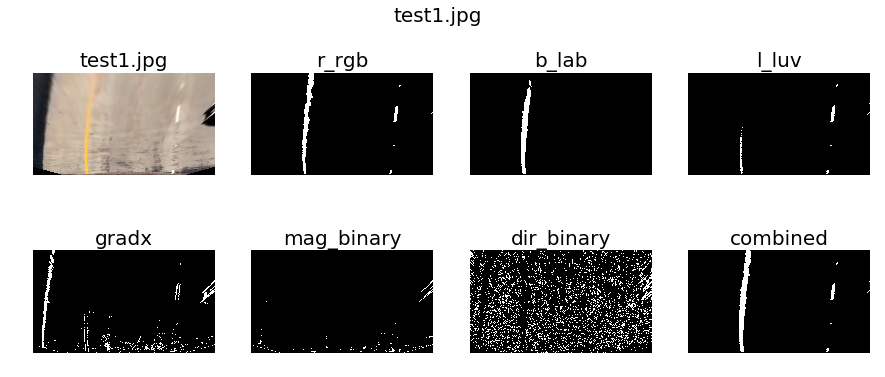

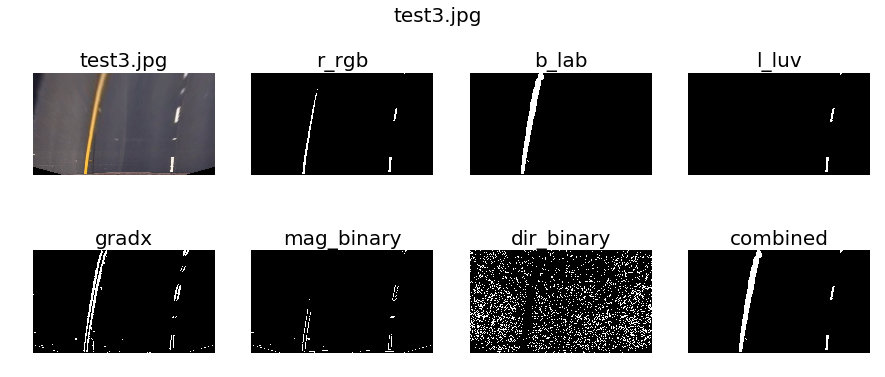

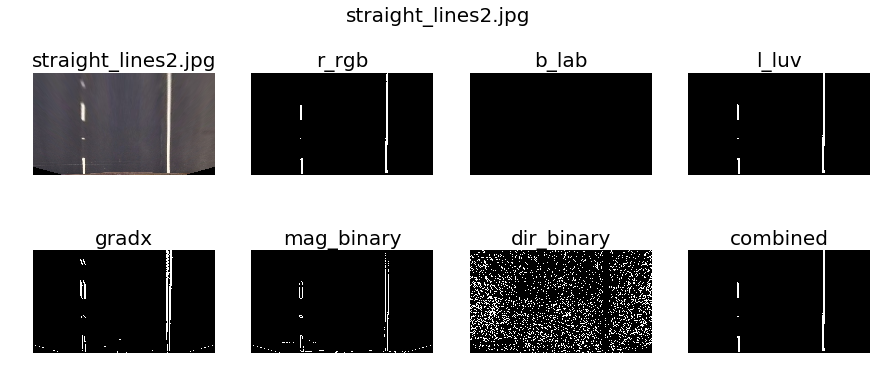

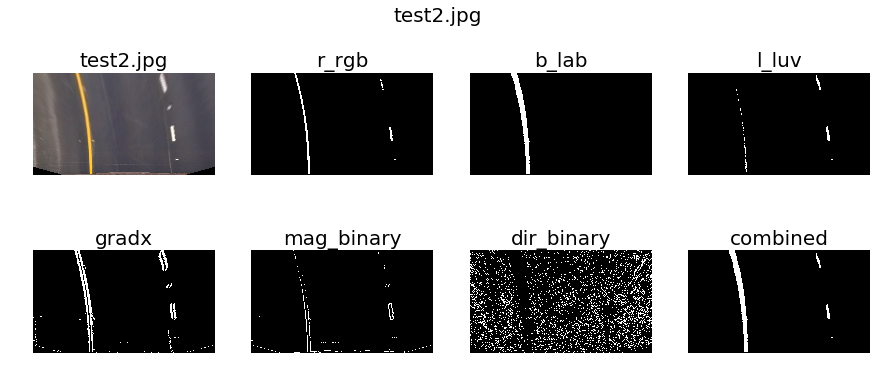

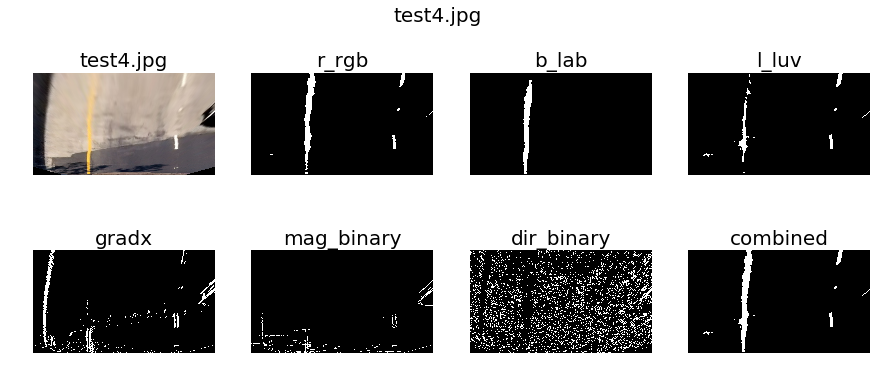

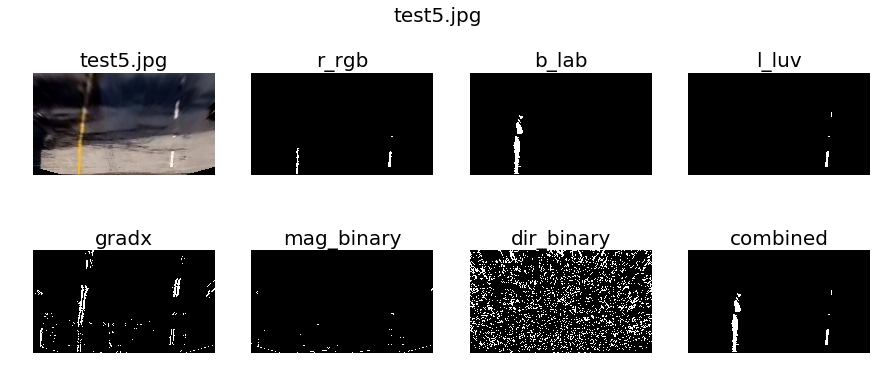

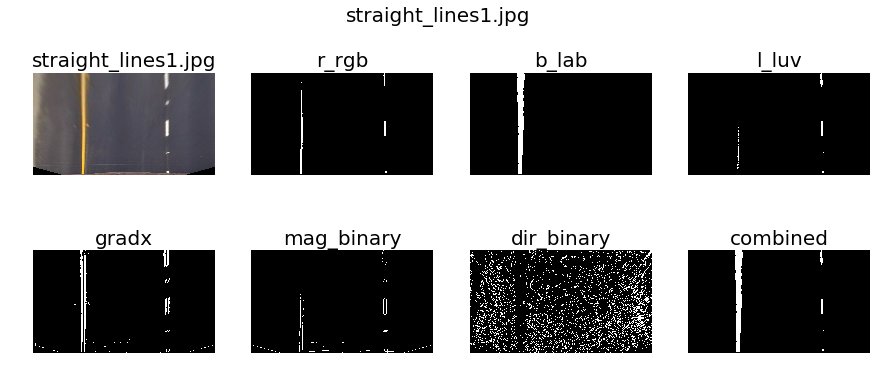

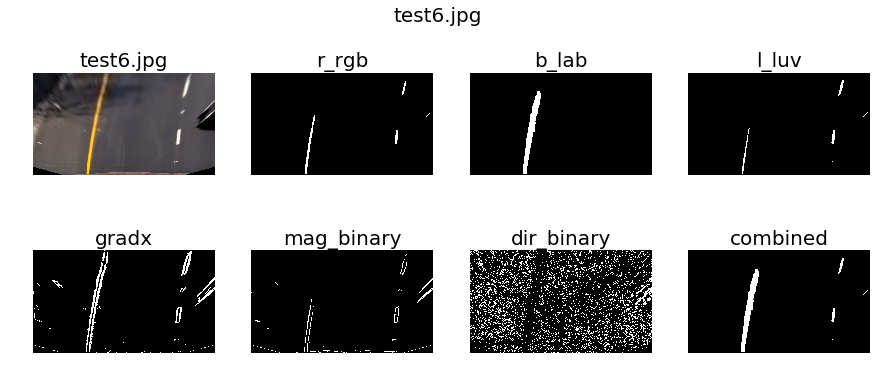

In [19]:
combineds = []
for fname in test_images:
    img = mpimg.imread(fname)
    undist = cv2.undistort(img, mtx, dist, None, mtx)    
    warped = cv2.warpPerspective(undist,M,img_size,flags=cv2.INTER_LINEAR)
    
    # color and gradient threshold 
    hsv = cv2.cvtColor(warped, cv2.COLOR_RGB2HSV)
    v_channel = hsv[:,:,2]
    gradx = abs_sobel_thresh(v_channel,orient='x',thresh=(17,255))
    mag_binary = mag_thresh(v_channel, sobel_kernel=3, mag_thresh=(33, 255))
    dir_binary = dir_threshold(v_channel, sobel_kernel=15, dir_thresh=(0.8, 1.1))
    r_rgb = color_select(warped, 'RGB', 'R', (225,255))
    b_lab = color_select(warped, 'LAB', 'B', (150,255))
    l_luv = color_select(warped, 'LUV', 'L', (212,255))
    
    combined = np.zeros_like(img[:,:,0])
#     combined[((b_lab==1)|(l_luv==1)|(r_rgb==1)|(gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
#     combined[(b_lab==1)|(l_luv==1)|(r_rgb==1)|(gradx==1)]=1
    combined[(b_lab==1)|(l_luv==1)|(r_rgb==1)]=1

    combineds.append(combined)
    
    save_combined = np.dstack((combined*255,combined*255,combined*255))
    cv2.imwrite(os.path.join('output_images','warped_combined_'+os.path.basename(fname)),save_combined)
    
    show_images = [warped,r_rgb,b_lab,l_luv,gradx,mag_binary,dir_binary,combined]
    titles = [os.path.basename(fname),'r_rgb','b_lab','l_luv','gradx','mag_binary','dir_binary','combined']
    f, axes = plt.subplots(2, 4, figsize=(15, 6))
    f.suptitle(os.path.basename(fname), fontsize=20)
    axes = axes.ravel()
    for i in range(len(axes)):
        axes[i].imshow(show_images[i],'gray')
        axes[i].set_title(titles[i], fontsize=20)
        axes[i].axis('off')

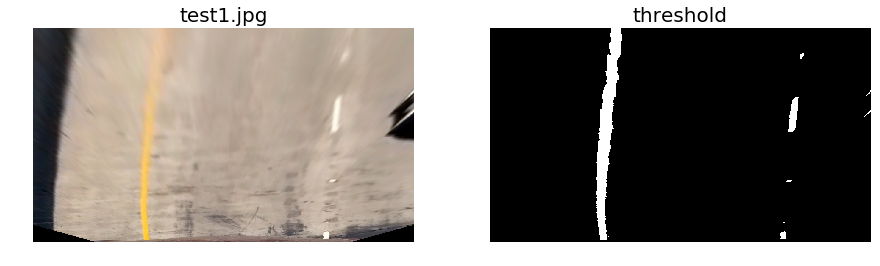

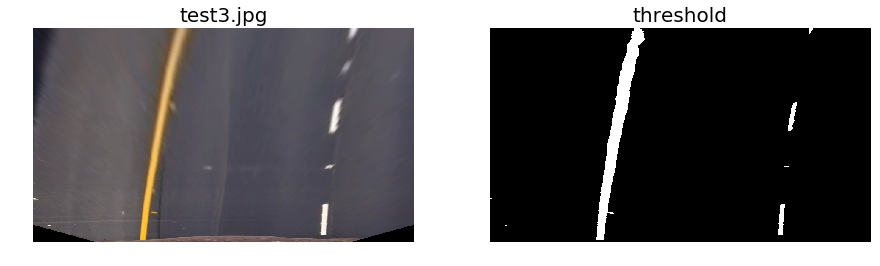

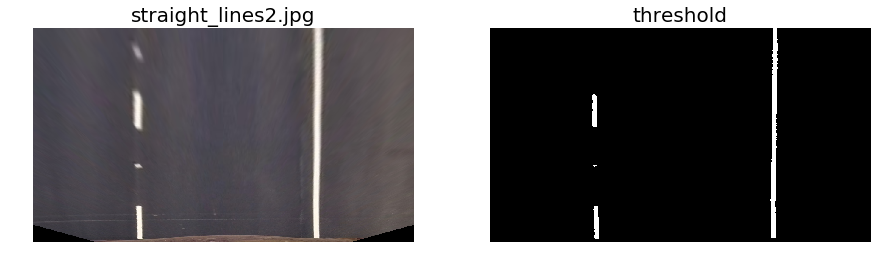

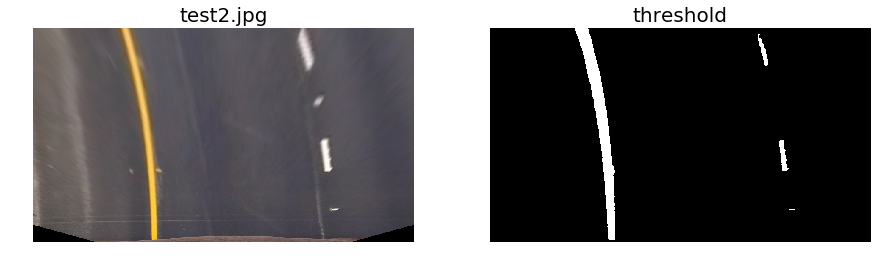

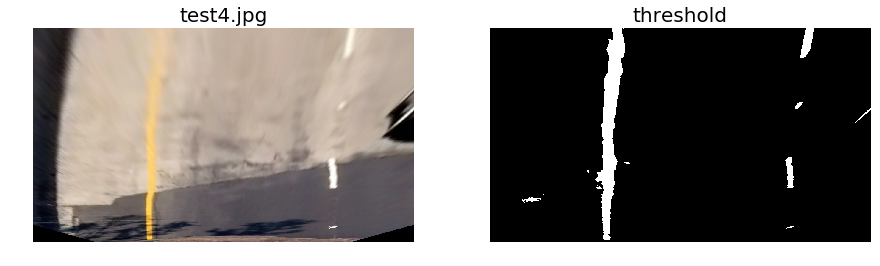

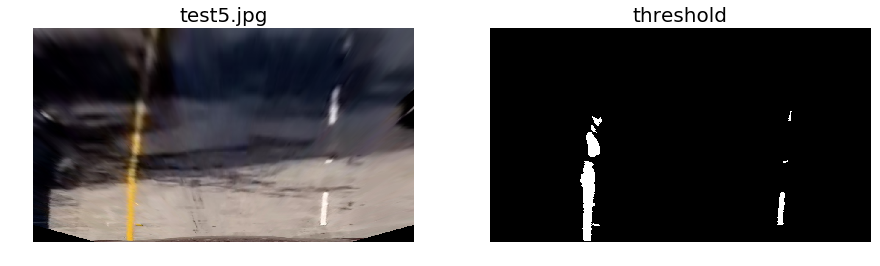

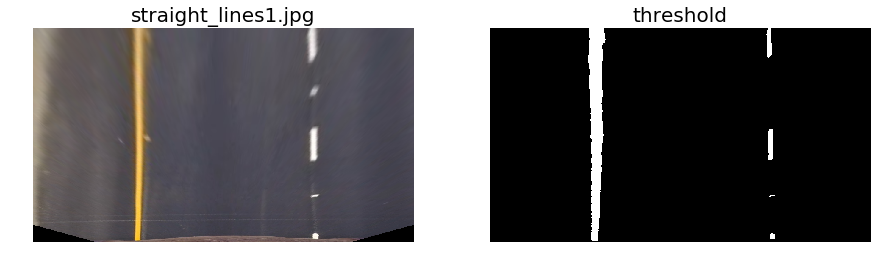

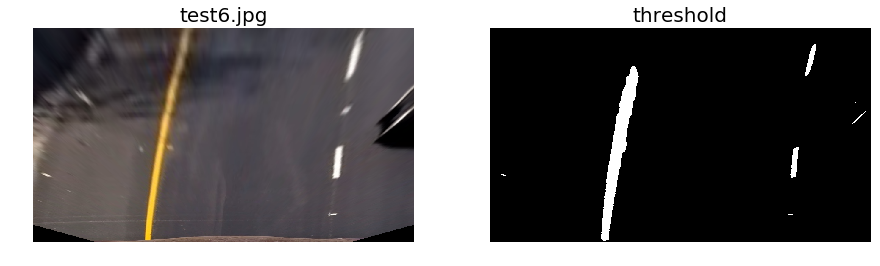

In [20]:
combineds = []
for fname in test_images:
    img = mpimg.imread(fname)
    undist = cv2.undistort(img, mtx, dist, None, mtx)    
    warped = cv2.warpPerspective(undist,M,img_size,flags=cv2.INTER_LINEAR)
    
    r_rgb = color_select(warped, 'RGB', 'R', (225,255))
    b_lab = color_select(warped, 'LAB', 'B', (150,255))
    l_luv = color_select(warped, 'LUV', 'L', (212,255))
    
    combined = np.zeros_like(img[:,:,0])
    combined[(b_lab==1)|(l_luv==1)|(r_rgb==1)]=1

    combineds.append(combined)
    
    save_combined = np.dstack((combined*255,combined*255,combined*255))
    cv2.imwrite(os.path.join('output_images','warped_combined_'+os.path.basename(fname)),save_combined)
    
    show_images = [warped,combined]
    titles = [os.path.basename(fname),'threshold']
    f, axes = plt.subplots(1, 2, figsize=(15,4))
    axes = axes.ravel()
    for i in range(len(axes)):
        axes[i].imshow(show_images[i],'gray')
        axes[i].set_title(titles[i], fontsize=20)
        axes[i].axis('off')

## Locate the Lane Lines and Fit a Polynomial

### Implement Sliding Windows and Fit a Polynomial

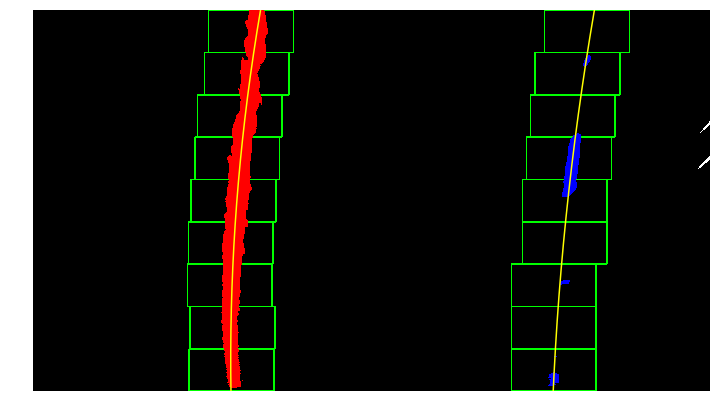

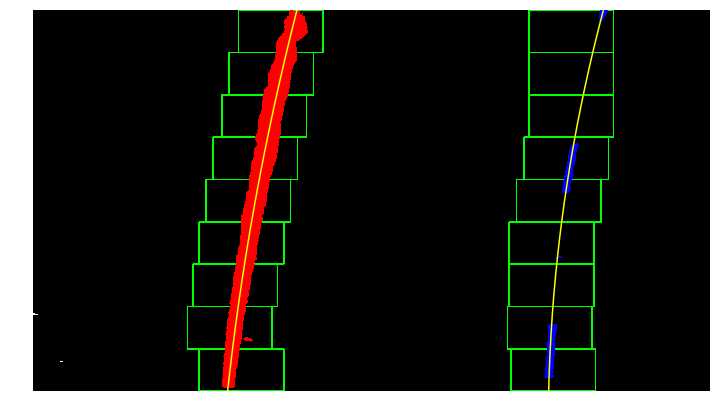

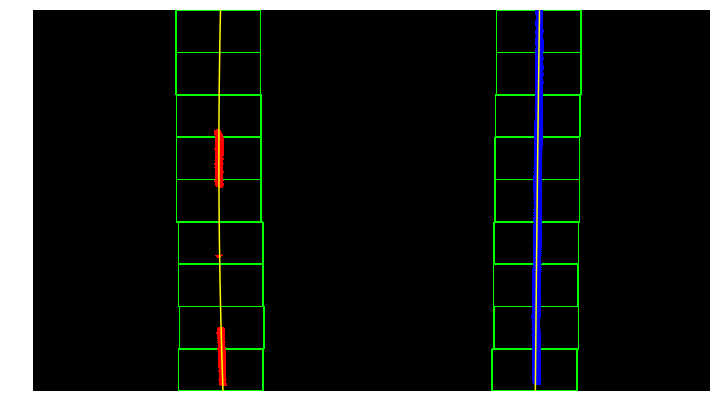

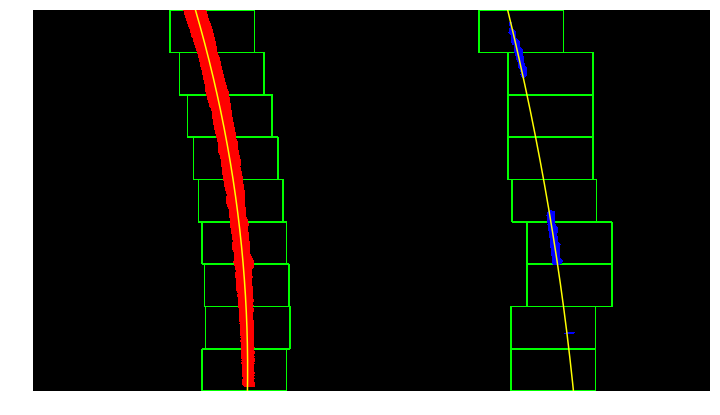

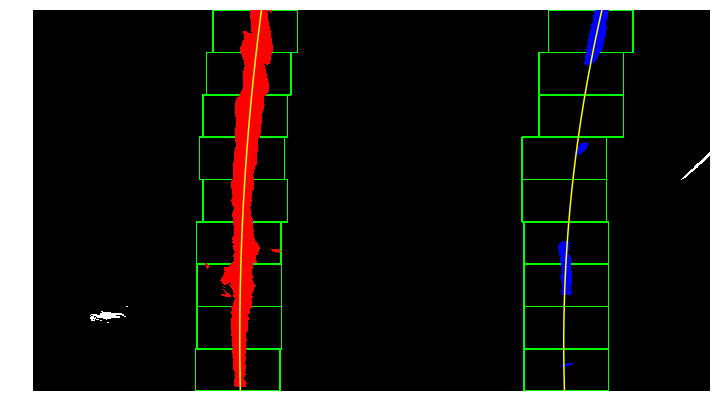

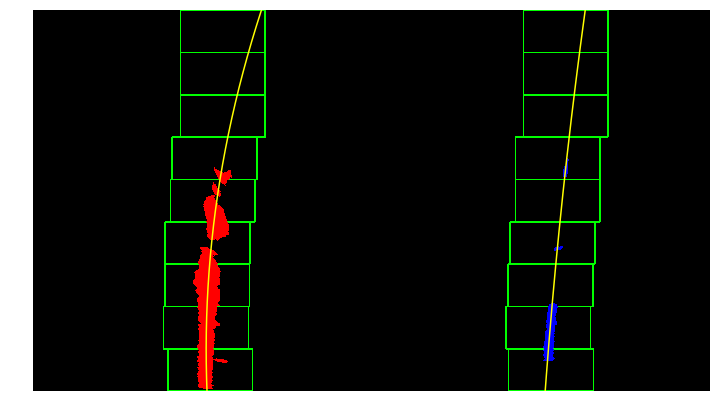

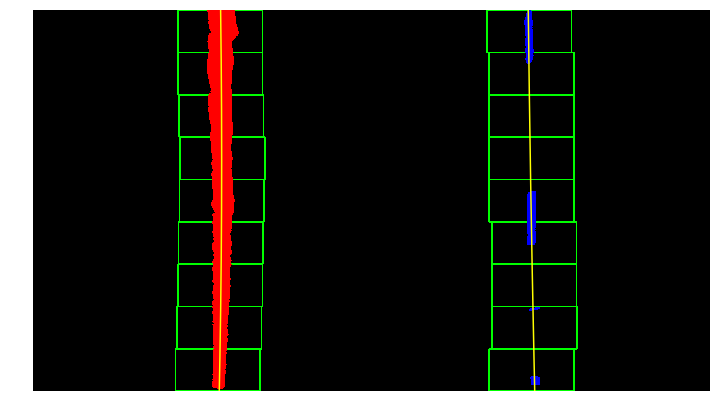

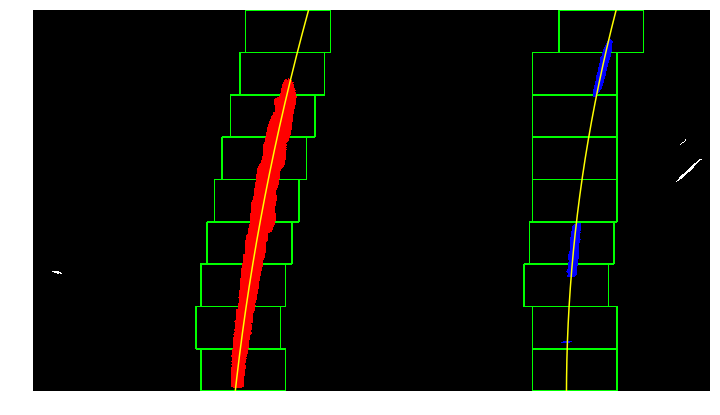

In [21]:
for binary_warped in combineds:
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255

    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)


    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    plt.figure(figsize=(15,7))
    plt.imshow(out_img)
    plt.plot(left_fitx,  ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.axis('off')

### Skip the sliding windows step once I know where the lines are

(0.0, 1280.0, 720.0, 0.0)

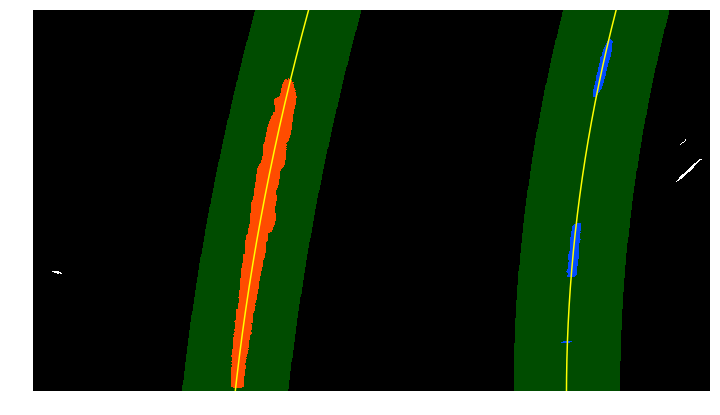

In [22]:
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
margin = 100
left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
left_fit[1]*nonzeroy + left_fit[2] + margin))) 

right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
right_fit[1]*nonzeroy + right_fit[2] + margin)))  

# Again, extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds]
# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)
# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]


# Create an image to draw on and an image to show the selection window
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
window_img = np.zeros_like(out_img)
# Color in left and right line pixels
out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

# Generate a polygon to illustrate the search window area
# And recast the x and y points into usable format for cv2.fillPoly()
left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
left_line_pts = np.hstack((left_line_window1, left_line_window2))
right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
right_line_pts = np.hstack((right_line_window1, right_line_window2))

# Draw the lane onto the warped blank image
cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
plt.figure(figsize=(15,7))
plt.imshow(result)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)
plt.axis('off')